1.4.2


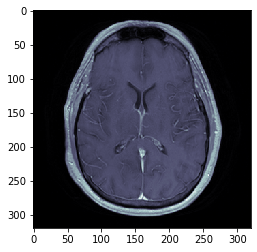

In [1]:
import pydicom
import matplotlib.pyplot as plt
print(pydicom.__version__)
filename = '../data/fastMRI_brain_DICOM/154454583751/681.dcm'
ds = pydicom.dcmread(filename)
plt.imshow(ds.pixel_array, cmap=plt.cm.bone)

In [2]:
# clear out the texts and dirs be careful!!!
#!rm ../data/fastMRI_knee_NUMPY/*
!rm completed_fastmri.txt
!rm failed_fastmri.txt
!touch completed_fastmri.txt
!touch failed_fastmri.txt

In [24]:
%%file numpy_fastmri_conversion.py
import pydicom as dicom
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
from skimage.transform import rescale, resize, downscale_local_mean

def get_dicom_ImgOrient(folder_path, filename, raw=True):
    # returns the 1 x 6 vector from the message from face book
    # raw - True gives raw vector
    # raw - False gives elements rounded to int
    # Axial looks to have orient : [1, 0, 0, 0, 1, 0]
    # Not sure about other ones ... don't have any examples on hand

    ds = dicom.dcmread(os.path.join(folder_path, filename))
    data = list(ds.data_element('ImageOrientationPatient').value)
    if raw: return [float(di) for di in data]
    else: return [int(round(float(di))) for di in data]

def get_dicom_nparray(folder_path, filename):
    ds = dicom.dcmread(os.path.join(folder_path, filename))
    return ds.pixel_array

# new shape
shape = (224, 224)

# make it True if you want to see all of them plotted
verbose = True

# Specify the .dcm folder path
folder_path = "../data/knee_mri_clinical_seq" # _batch_2 must be done too

# Specify the new path for numpy arrays
destination_path = "../data/fastMRI_knee_NUMPY"

# This is a big ol list of the currently completed folders
complete_file = "completed_fastmri.txt"
failed_file = "failed_fastmri.txt"

with open(complete_file) as f:
    complete_set = f.readlines()
complete_set = set([s.strip("\n") for s in complete_set])

# go through all folders!
for folder in [folder for folder in os.listdir(folder_path) \
             if os.path.isdir(os.path.join(folder_path, folder))]:
    # path to 2nd folder
    folder_path_2 = os.path.join(folder_path,folder)
    for folder2 in [folder2 for folder2 in os.listdir(folder_path_2) if os.path.isdir(os.path.join(folder_path_2, folder2))]:
        # path to 3rd folder
        folder_path_3 = os.path.join(folder_path_2,folder2)
        for folder3 in [folder3 for folder3 in os.listdir(folder_path_3) if os.path.isdir(os.path.join(folder_path_3, folder3))]:
            if folder3 not in complete_set:
                folder_path_4 = os.path.join(folder_path_3,folder3)
                dicoms = [fh for fh in os.listdir(folder_path_4) if os.path.isfile(os.path.join(folder_path_4, fh))]
                nums = [int(x.replace(".","_").split("_")[0]) for x in dicoms]
                # sort dicoms by their num
                dicoms = [x for _,x in sorted(zip(nums,dicoms))]
                nums.sort()
                try:
                    arr_ls = [get_dicom_nparray(folder_path_4, file).astype(np.float32) for file in dicoms]
                    fin_arr = np.stack([resize(arr, shape, anti_aliasing=True) for arr in arr_ls])
                    if verbose:
                        for i, arr in enumerate(fin_arr[15:16]):
                            print(f"{arr.shape} {nums[i]} {arr.dtype}")
                            plt.imshow(arr, cmap=plt.cm.bone)
                            plt.show()
                            plt.close()
                        
                    np.save(os.path.join(destination_path, folder3), fin_arr)
                except Exception as e:
                    # save failed files to a text to see how many there are
                    with open(failed_file, "a") as fh:
                        fh.write(f"{folder3}: {e}\n")
                    
                complete_set.add(folder3)
                # update the complete_file list
                with open(complete_file, "a") as fh:
                    fh.write(f"\n{folder3}")
    

Overwriting numpy_fastmri_conversion.py


In [36]:
!python numpy_fastmri_conversion.py > output_parse.txt

MR10_054f36c3.npy  MR6_f431789b.npy  MR9_e159a83c.npy
MR4_078e35f3.npy   MR7_70cd36c7.npy


In [28]:
!sudo mkdir ../data/fastMRI_knee_NUMPY/sagittal
!sudo mkdir ../data/fastMRI_knee_NUMPY/coronal
!sudo mkdir ../data/fastMRI_knee_NUMPY/axial

mkdir: cannot create directory ‘../data/fastMRI_knee_NUMPY/sagittal’: File exists
mkdir: cannot create directory ‘../data/fastMRI_knee_NUMPY/coronal’: File exists
mkdir: cannot create directory ‘../data/fastMRI_knee_NUMPY/axial’: File exists


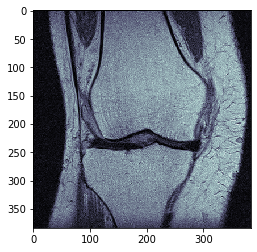

sudo cp ../data/fastMRI_knee_NUMPY/MR5_ebef6b1a.npy ../data/fastMRI_knee_NUMPY/coronal/MR5_ebef6b1a.npy 0


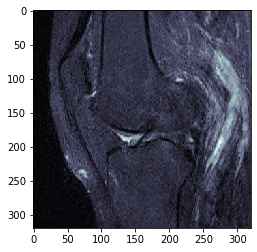

sudo cp ../data/fastMRI_knee_NUMPY/MR4_078e35f3.npy ../data/fastMRI_knee_NUMPY/sagittal/MR4_078e35f3.npy 0


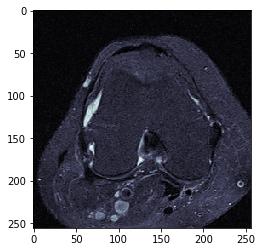

sudo cp ../data/fastMRI_knee_NUMPY/MR2_5f250f64.npy ../data/fastMRI_knee_NUMPY/axial/MR2_5f250f64.npy 0


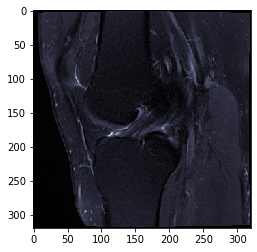

sudo cp ../data/fastMRI_knee_NUMPY/MR10_054f36c3.npy ../data/fastMRI_knee_NUMPY/sagittal/MR10_054f36c3.npy 0


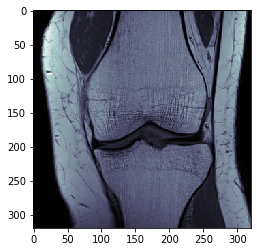

sudo cp ../data/fastMRI_knee_NUMPY/MR8_bd52ee76.npy ../data/fastMRI_knee_NUMPY/coronal/MR8_bd52ee76.npy 0


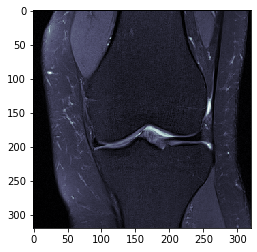

sudo cp ../data/fastMRI_knee_NUMPY/MR5_f777f543.npy ../data/fastMRI_knee_NUMPY/coronal/MR5_f777f543.npy 2


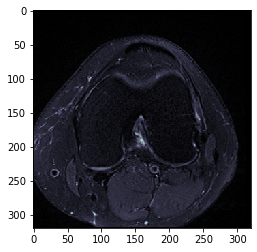

sudo cp ../data/fastMRI_knee_NUMPY/MR4_80108aa8.npy ../data/fastMRI_knee_NUMPY/axial/MR4_80108aa8.npy 0


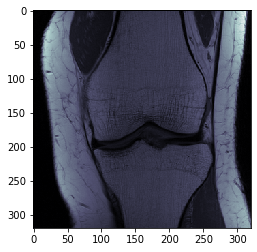

sudo cp ../data/fastMRI_knee_NUMPY/MR7_a6e971df.npy ../data/fastMRI_knee_NUMPY/coronal/MR7_a6e971df.npy 0


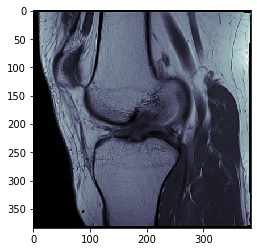

sudo cp ../data/fastMRI_knee_NUMPY/MR9_e159a83c.npy ../data/fastMRI_knee_NUMPY/sagittal/MR9_e159a83c.npy 0


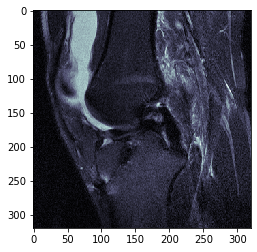

sudo cp ../data/fastMRI_knee_NUMPY/MR7_70cd36c7.npy ../data/fastMRI_knee_NUMPY/sagittal/MR7_70cd36c7.npy 0


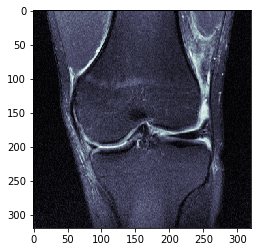

sudo cp ../data/fastMRI_knee_NUMPY/MR3_d2e5db15.npy ../data/fastMRI_knee_NUMPY/coronal/MR3_d2e5db15.npy 0


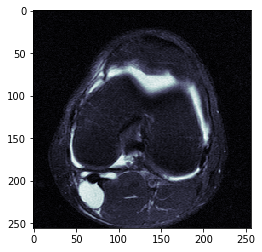

sudo cp ../data/fastMRI_knee_NUMPY/MR2_4f9a7220.npy ../data/fastMRI_knee_NUMPY/axial/MR2_4f9a7220.npy 0


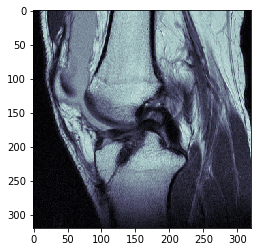

sudo cp ../data/fastMRI_knee_NUMPY/MR6_f431789b.npy ../data/fastMRI_knee_NUMPY/sagittal/MR6_f431789b.npy 0


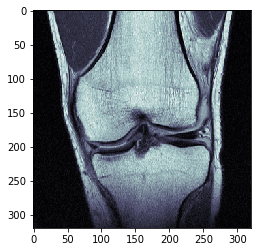

sudo cp ../data/fastMRI_knee_NUMPY/MR5_3e4efb2d.npy ../data/fastMRI_knee_NUMPY/coronal/MR5_3e4efb2d.npy 0


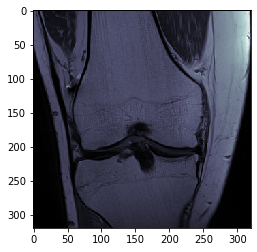

sudo cp ../data/fastMRI_knee_NUMPY/MR5_0b68ec00.npy ../data/fastMRI_knee_NUMPY/coronal/MR5_0b68ec00.npy 0


KeyboardInterrupt: 

In [35]:
%%file orientation_moving.py
import pydicom as dicom
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
from skimage.transform import rescale, resize, downscale_local_mean

def get_dicom_ImgOrient(folder_path, filename, raw=True):
    # returns the 1 x 6 vector from the message from face book
    # raw - True gives raw vector
    # raw - False gives elements rounded to int
    # Axial looks to have orient : [1, 0, 0, 0, 1, 0]
    # Not sure about other ones ... don't have any examples on hand

    ds = dicom.dcmread(os.path.join(folder_path, filename))
    data = list(ds.data_element('ImageOrientationPatient').value)
    if raw: return [float(di) for di in data]
    else: return [int(round(float(di))) for di in data]

def get_dicom_nparray(folder_path, filename):
    ds = dicom.dcmread(os.path.join(folder_path, filename))
    return ds.pixel_array

# make it True if you want to see all of them plotted
verbose = False

# Specify the .dcm folder path
folder_path = "../data/knee_mri_clinical_seq" # _batch_2 must be done too

# Specify the new path for numpy arrays
destination_path = "../data/fastMRI_knee_NUMPY"

# This is a big ol list of the currently completed folders
complete_file = "completed_fastmri.txt"
failed_file = "failed_fastmri.txt"

with open(complete_file) as f:
    complete_set = f.readlines()
complete_set = set([s.strip("\n") for s in complete_set])

sagittal,coronal,axial = set(),set(),set()
sagittal.add((0,1,0,0,0,1))
coronal.add((1,0,0,0,0,1))
axial.add(  (1,0,0,0,1,0))

# go through all folders!
for folder in [folder for folder in os.listdir(folder_path) \
             if os.path.isdir(os.path.join(folder_path, folder))]:
    # path to 2nd folder
    folder_path_2 = os.path.join(folder_path,folder)
    for folder2 in [folder2 for folder2 in os.listdir(folder_path_2) if os.path.isdir(os.path.join(folder_path_2, folder2))]:
        # path to 3rd folder
        folder_path_3 = os.path.join(folder_path_2,folder2)
        for folder3 in [folder3 for folder3 in os.listdir(folder_path_3) if os.path.isdir(os.path.join(folder_path_3, folder3))]:
            if folder3 not in complete_set:
                folder_path_4 = os.path.join(folder_path_3,folder3)
                dicoms = [fh for fh in os.listdir(folder_path_4) if os.path.isfile(os.path.join(folder_path_4, fh))]
                nums = [int(x.replace(".","_").split("_")[0]) for x in dicoms]
                # sort dicoms by their num
                dicoms = [x for _,x in sorted(zip(nums,dicoms))]
                nums.sort()
                try:
                    # look at middle file
                    dc_f = dicoms[int(len(dicoms)/2)]
                    arr = get_dicom_nparray(folder_path_4, dc_f).astype(np.float32)
                    orientation = get_dicom_ImgOrient(folder_path_4, dc_f)
                    orientation = tuple(abs(np.around(orientation,decimals=1).astype(int)))
                    if verbose:
                        plt.imshow(arr, cmap=plt.cm.bone)
                        plt.show()
                        plt.close()
                    if orientation in sagittal: dir_name = "/sagittal"
                    elif orientation in axial: dir_name = "/axial"
                    elif orientation in coronal: dir_name = "/coronal"
                    else: dir_name = ""
                    # current path
                    curr_path = os.path.join(destination_path, folder3+".npy")
                    # new path
                    new_path = os.path.join(destination_path + dir_name, folder3+".npy")
                    command = f"sudo mv {curr_path} {new_path}"
                    ec = os.system(command)
                    if ec != 0:
                        print(f"{command} {ec}")
                except Exception as e:
                    print(e)
                    # save failed files to a text to see how many there are
                    with open(failed_file, "a") as fh:
                        fh.write(f"{folder3}: {e}\n")
                    
                complete_set.add(folder3)
                # update the complete_file list
                with open(complete_file, "a") as fh:
                    fh.write(f"\n{folder3}")

In [65]:
%load_ext autoreload
%autoreload

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [16]:
%%file max_batch.py
import numpy as np
import os

# Specify the new path for numpy arrays
destination_path = "../data/fastMRI_knee_NUMPY"

# go through all folders!
m = 0
c = 0
for i,fh in enumerate([fh for fh in os.listdir(destination_path) if os.path.isfile(os.path.join(destination_path,fh))]):
    sh = np.load(os.path.join(destination_path,fh)).shape[0]
    m = max(m,sh)
    t = float(i)/len(os.listdir(destination_path))
    if c < t: 
        print(f"{str(c*100)[:5]}%")
        c = c + .05
print(m)

Writing max_batch.py


MR5_0634c93c


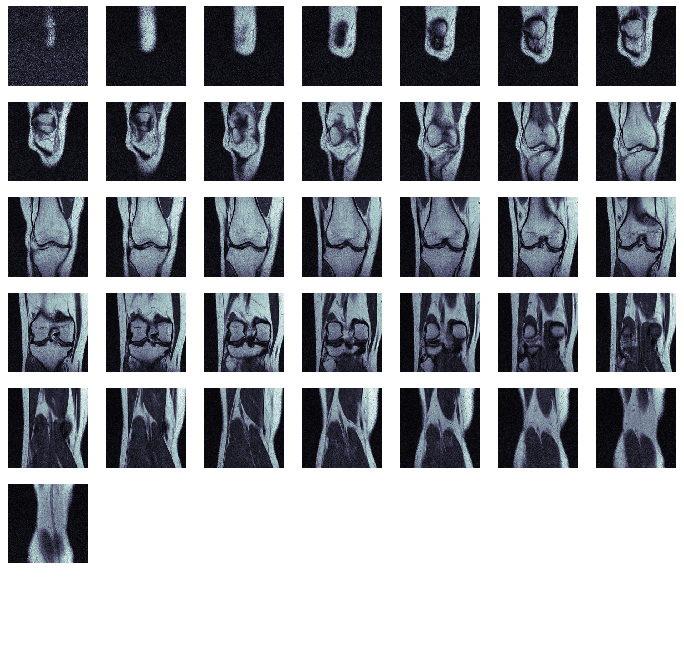

MR7_985bf4bf


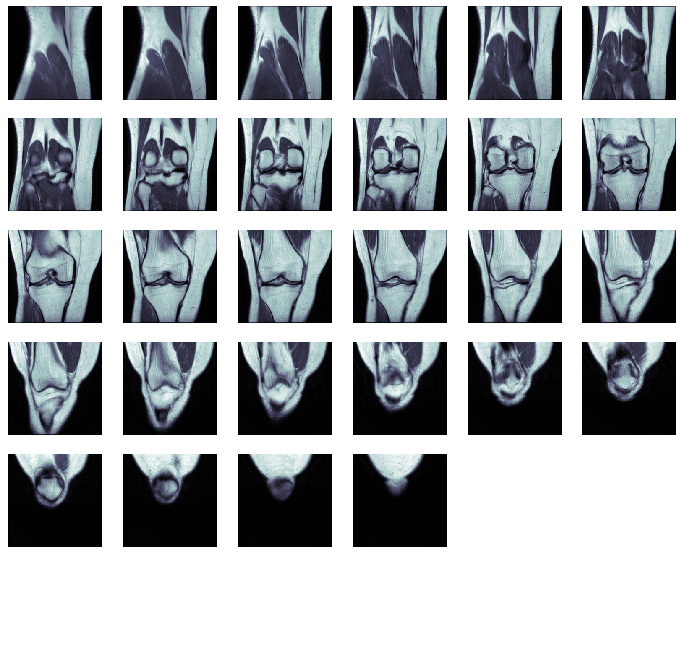

MR8_4b3c84eb


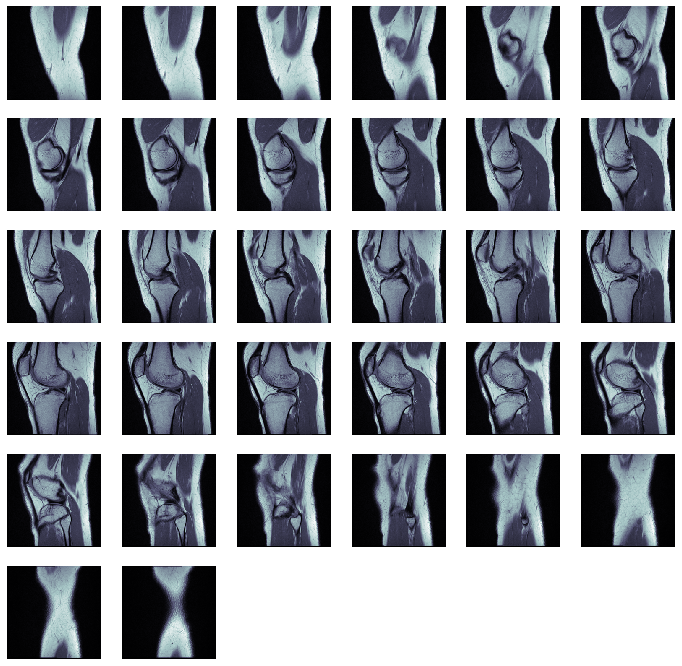

MR4_e8adf626


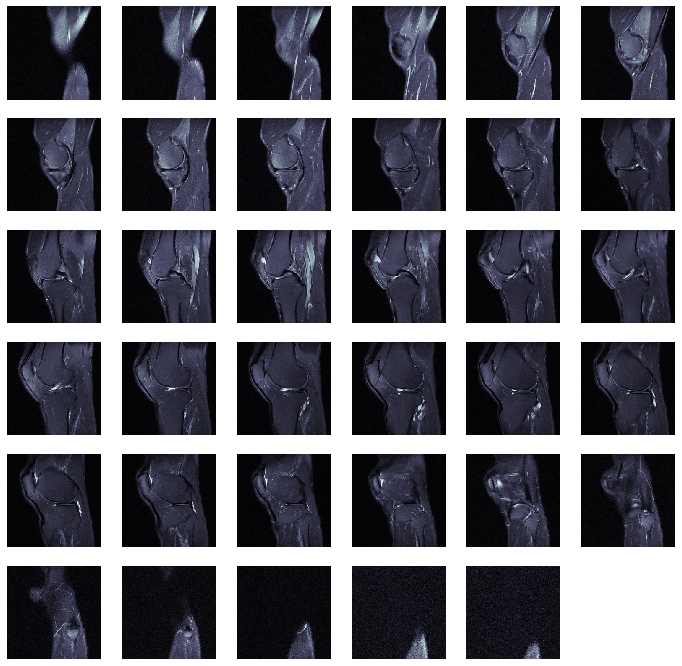

MR50100000_c28692a8


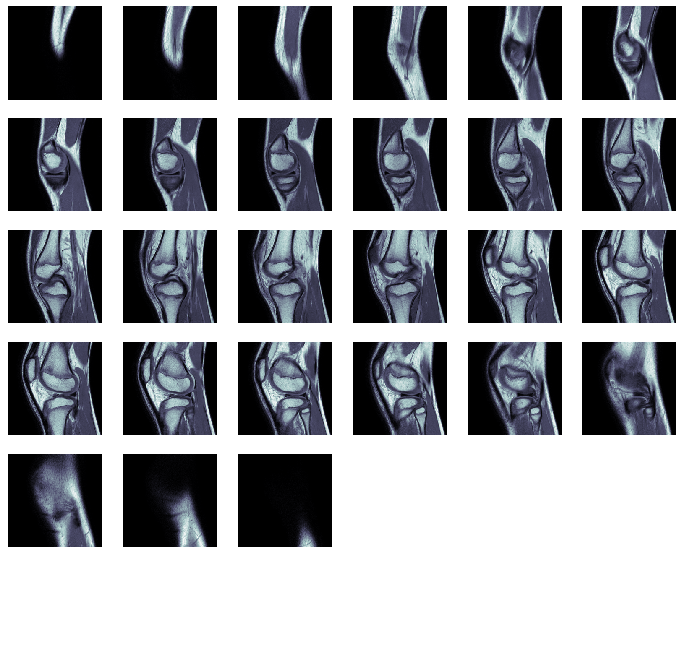

MR6_0441fcc6


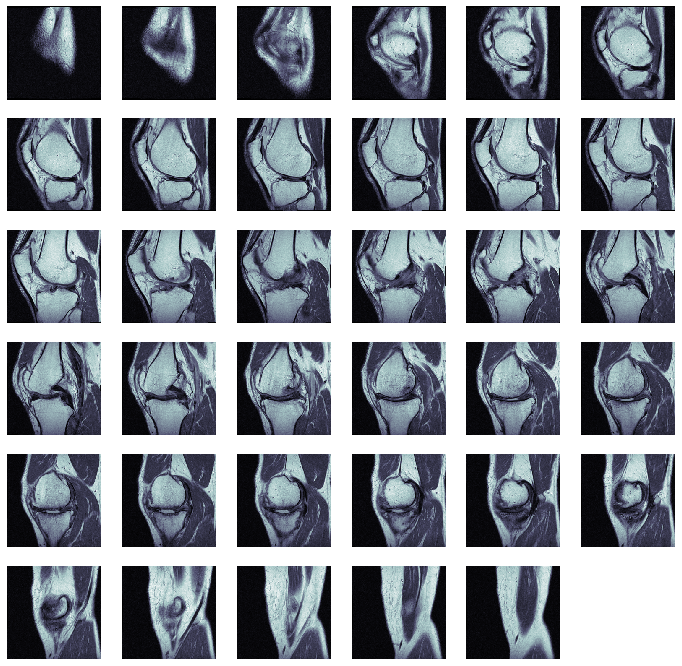

MR70100000_2f853faa


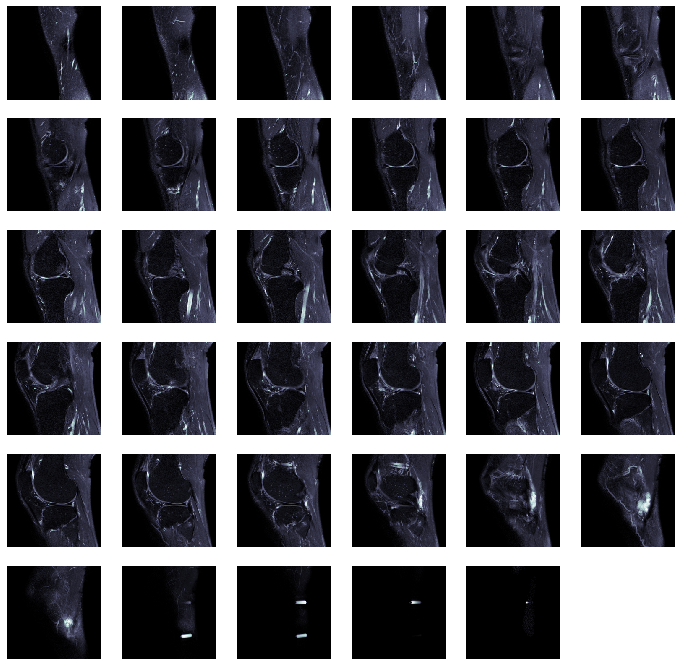

MR3_7beffbea


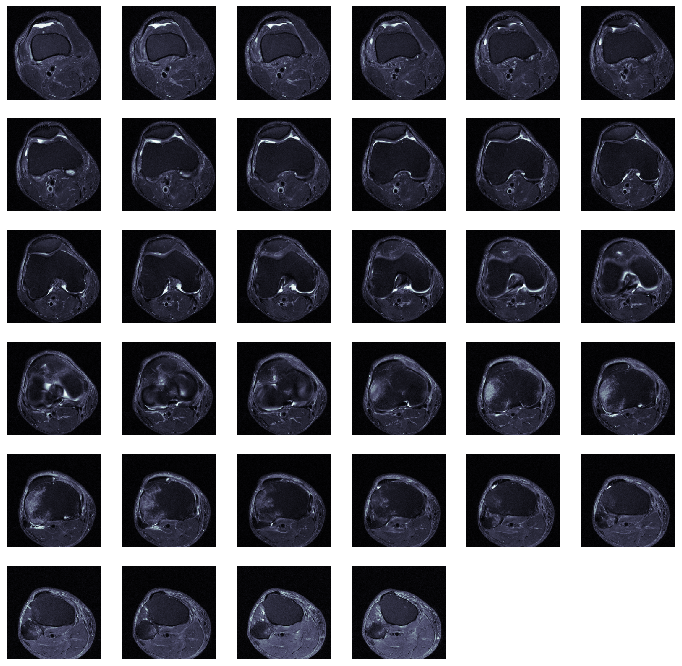

MR9_e6aeeaf1


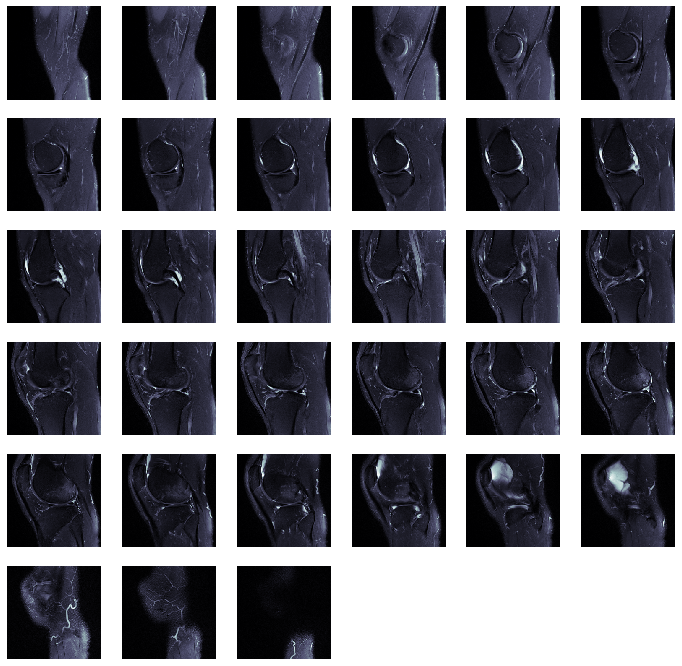

MR10_d1970f09


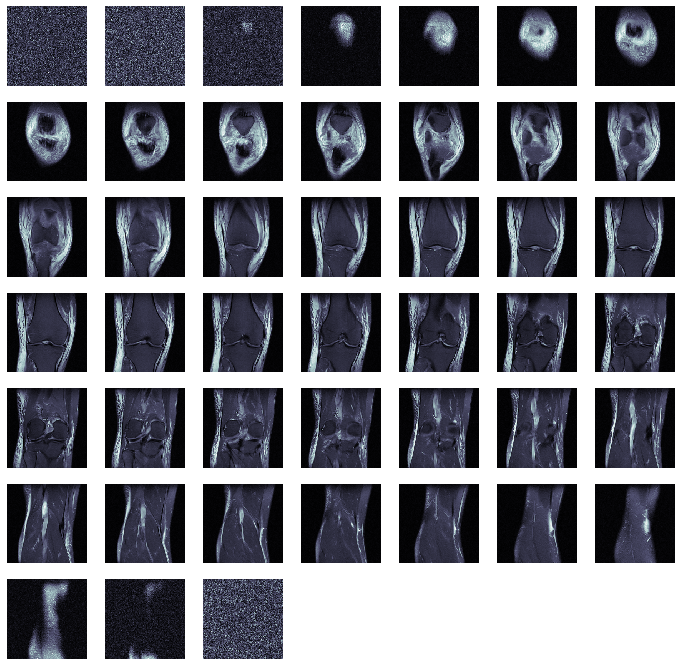

MR2_0e91a9b2


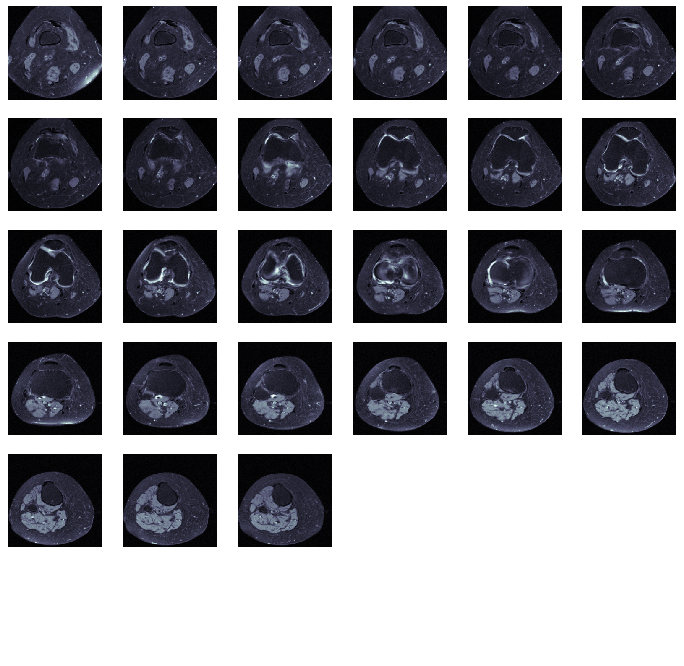

MR90100000_097de939


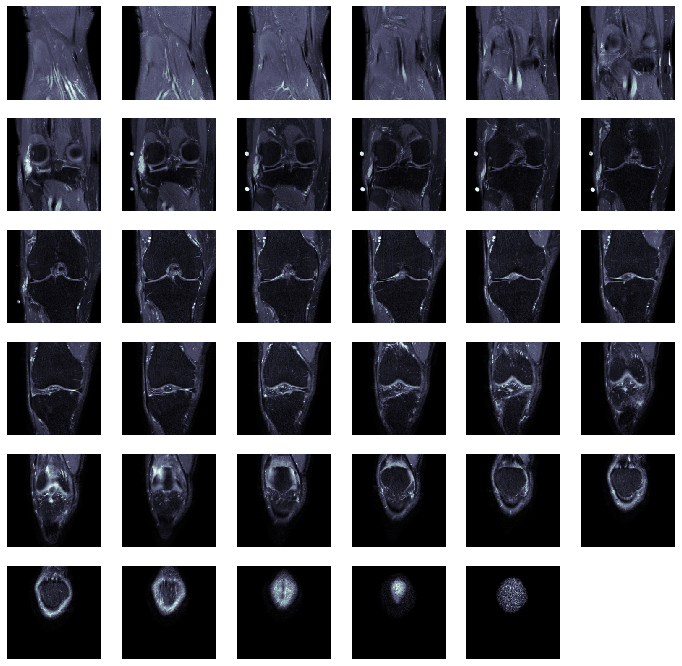

MR40100000_cffcad7f


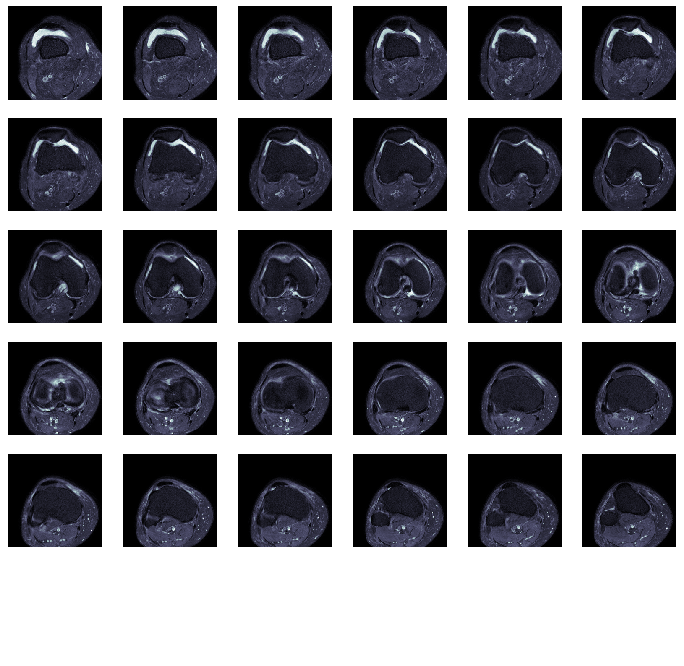

MR60100000_b192d0dc


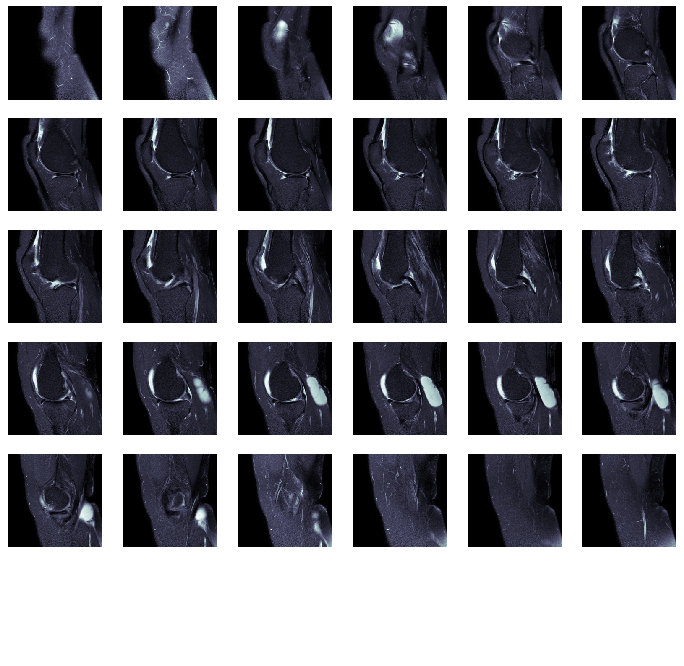

MR11_f2f6fad2


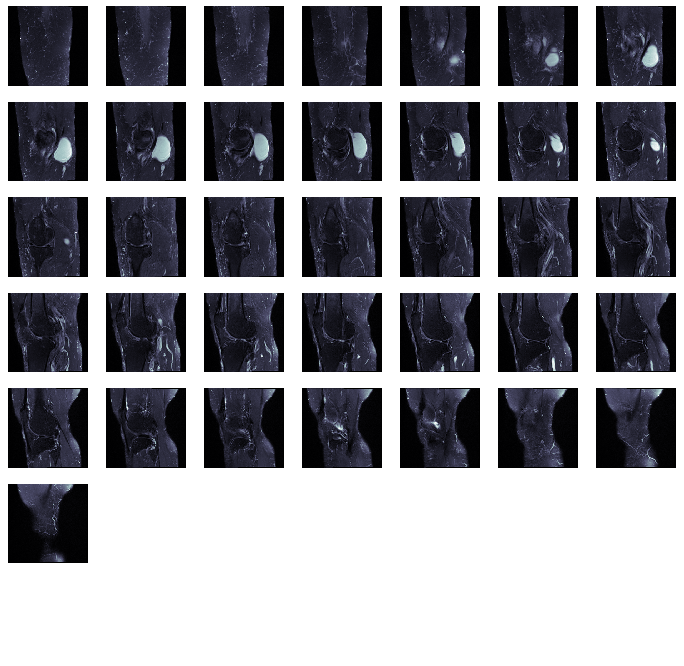

MR25_8528176e


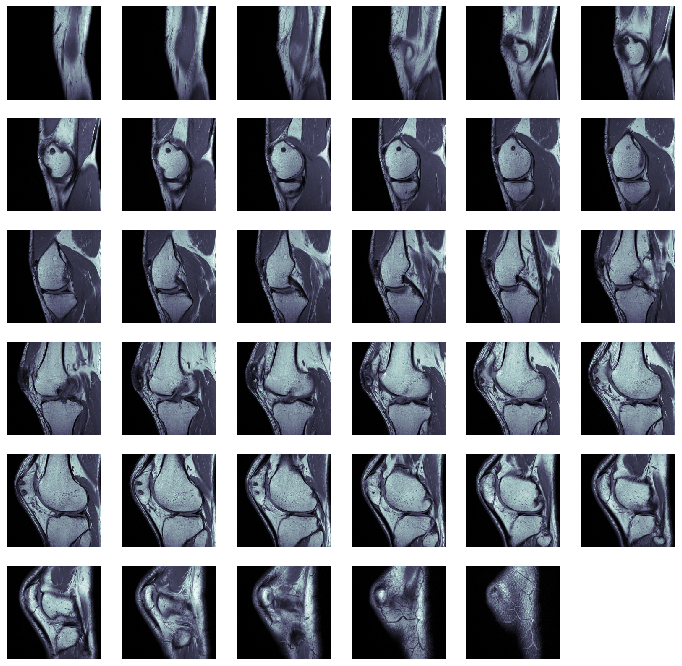

MR80100000_77381e90


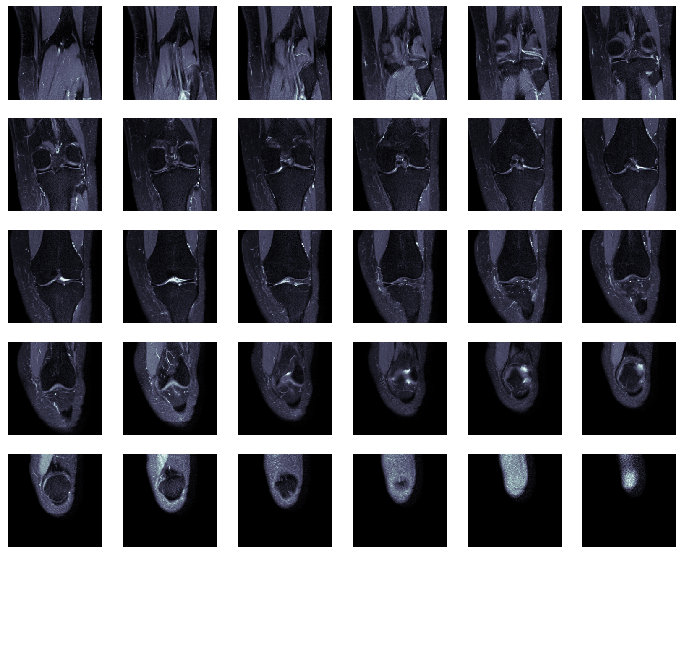

MR13_8816d1d9


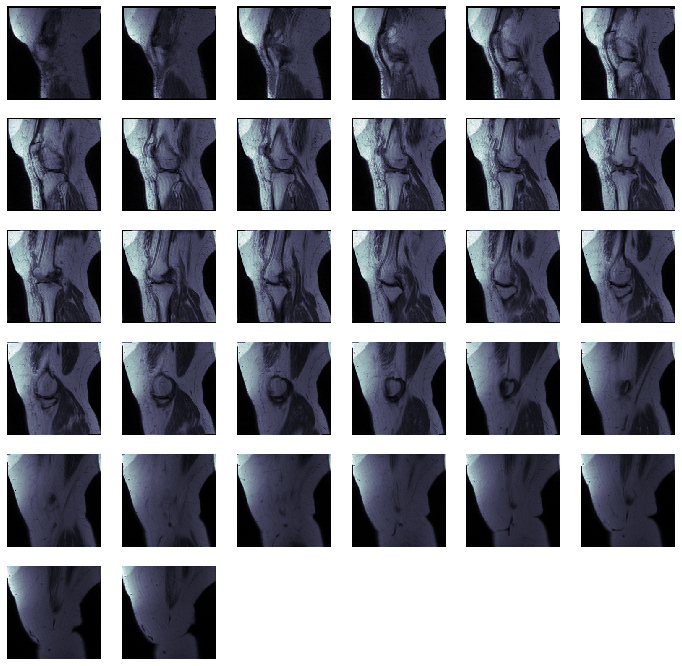

MR12_f3213b01


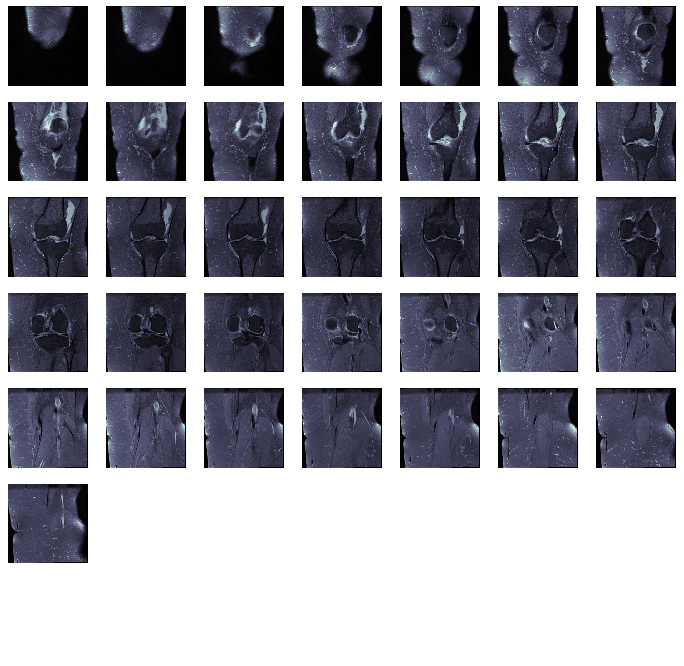

MR16_cf49ba6f


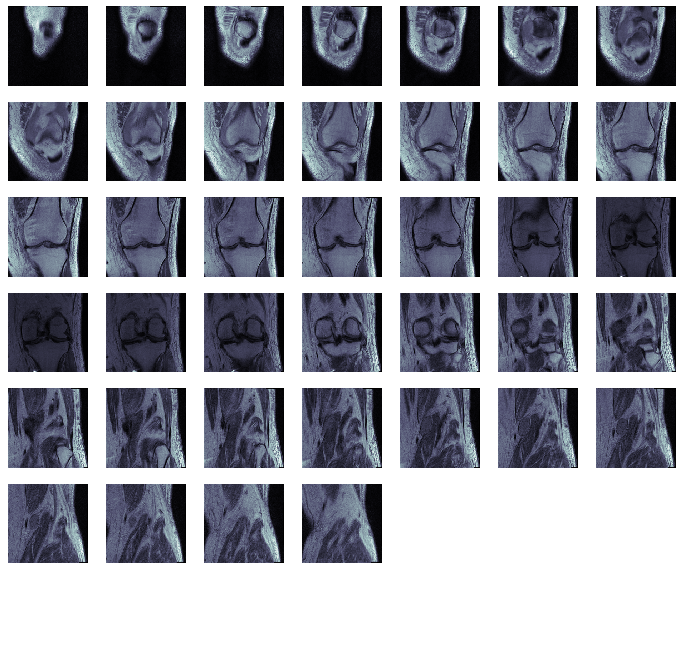

MR19_3b62ef2f


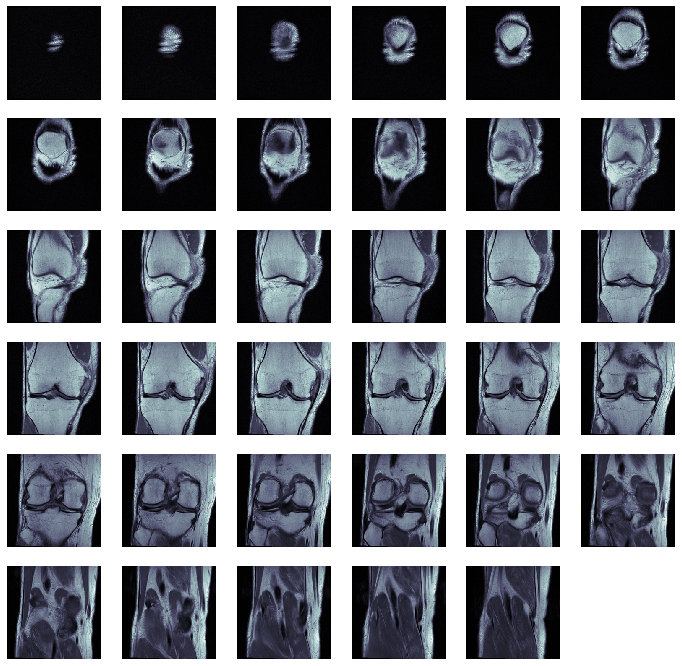

MR104_54255e0b


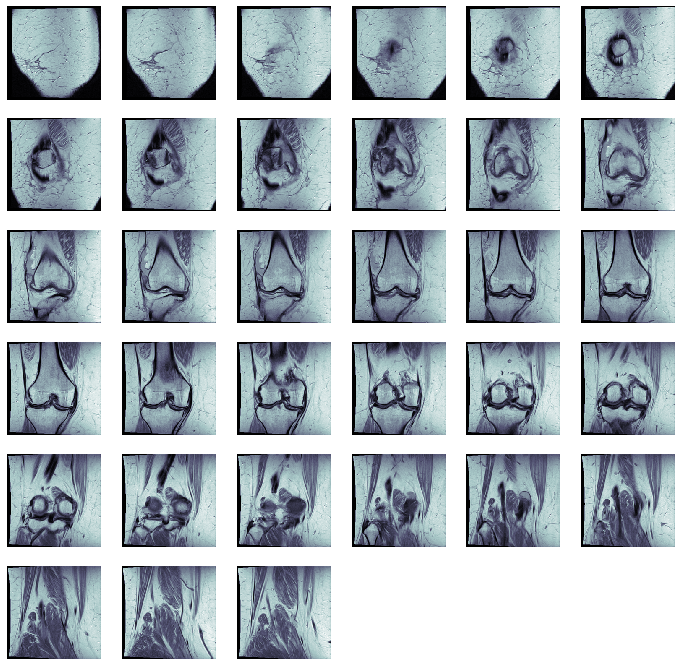

MR23_d20c97ea


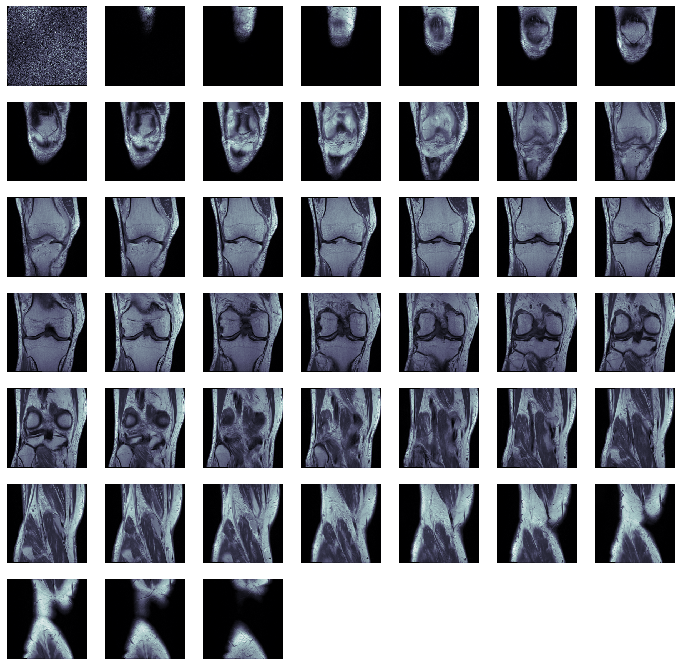

MR18_045b4dd8


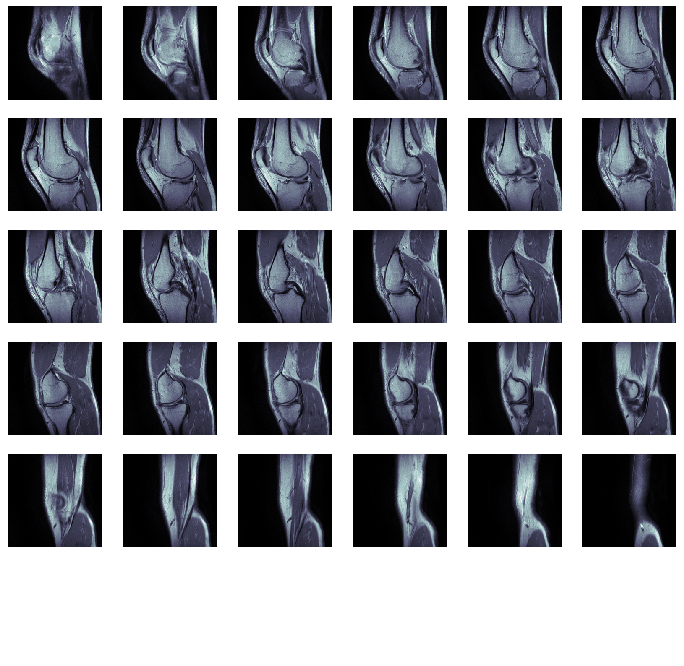

MR26_e324b80e


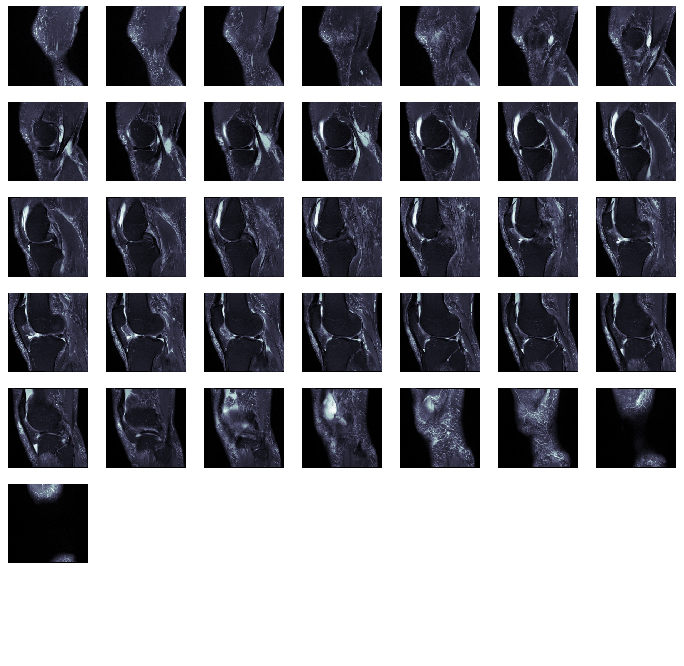

MR530_6d0b9e48


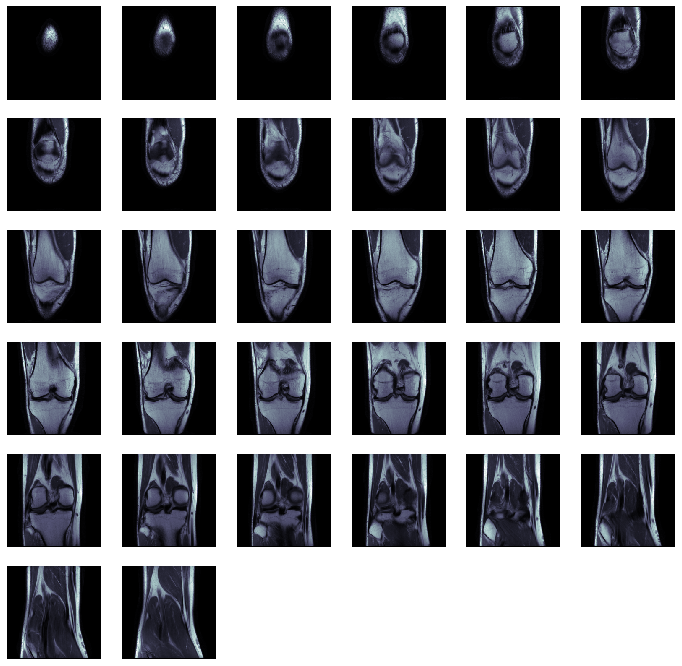

MR7001_af88d628


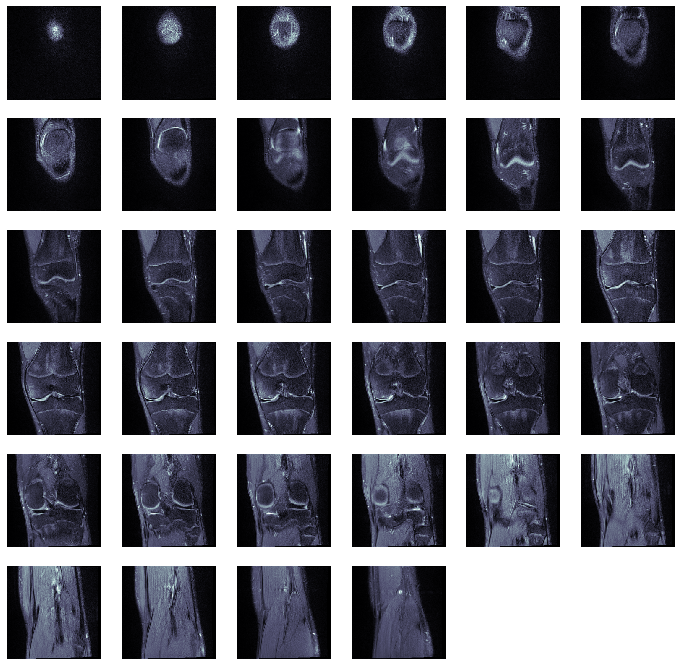

MR14_513d61ad


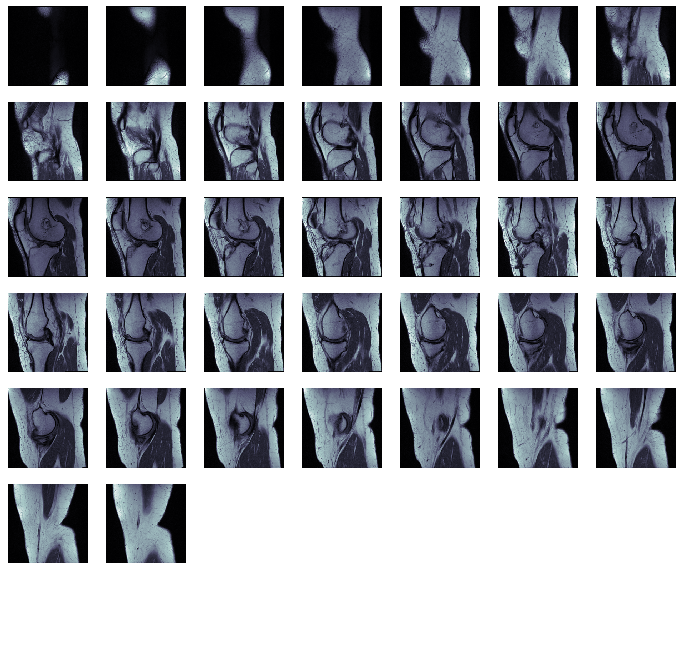

MR15_58f5451f


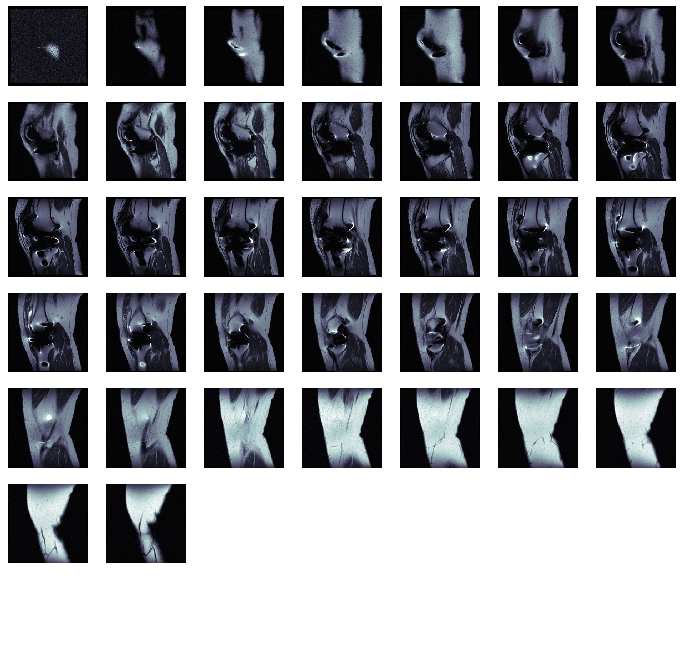

MR301_f9caccf0


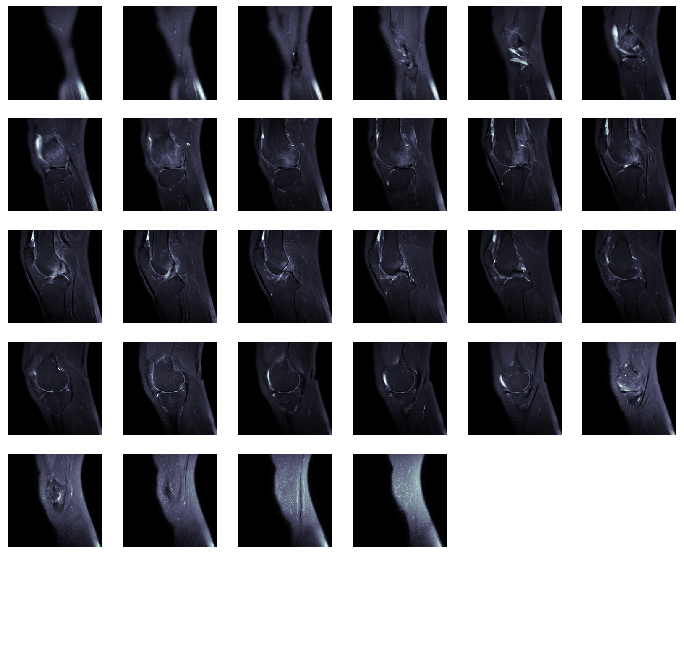

MR90_31bb0421


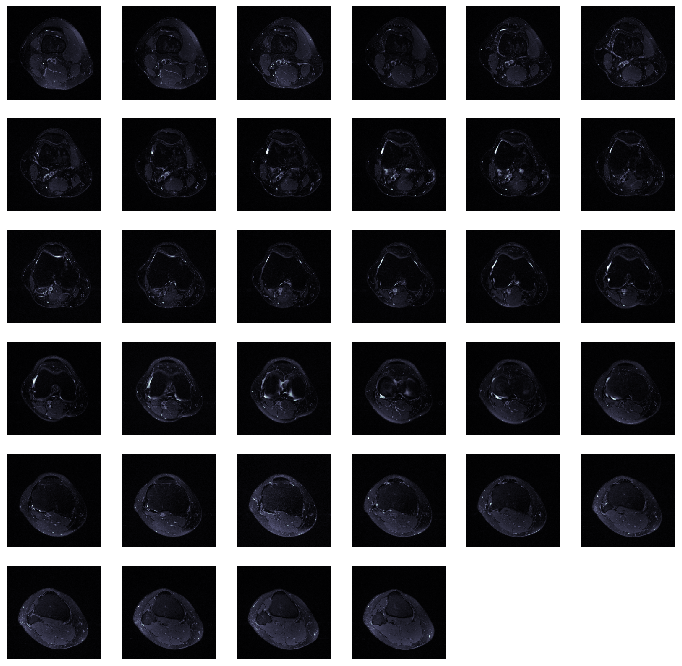

MR100100000_7b710f5b


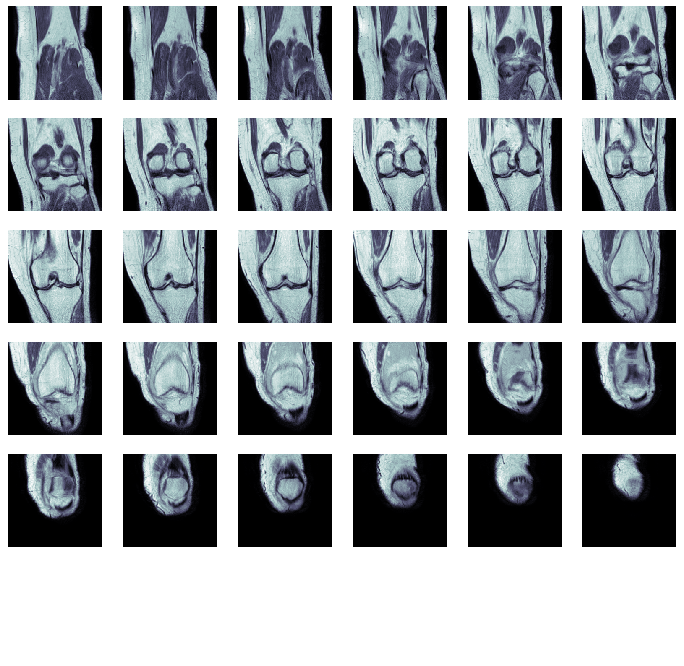

MR40005_c37b3329


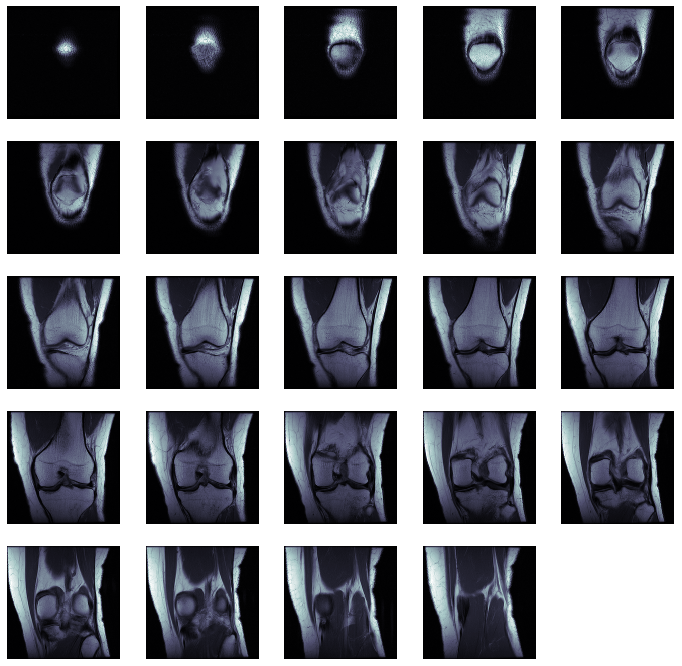

MR801_68221240


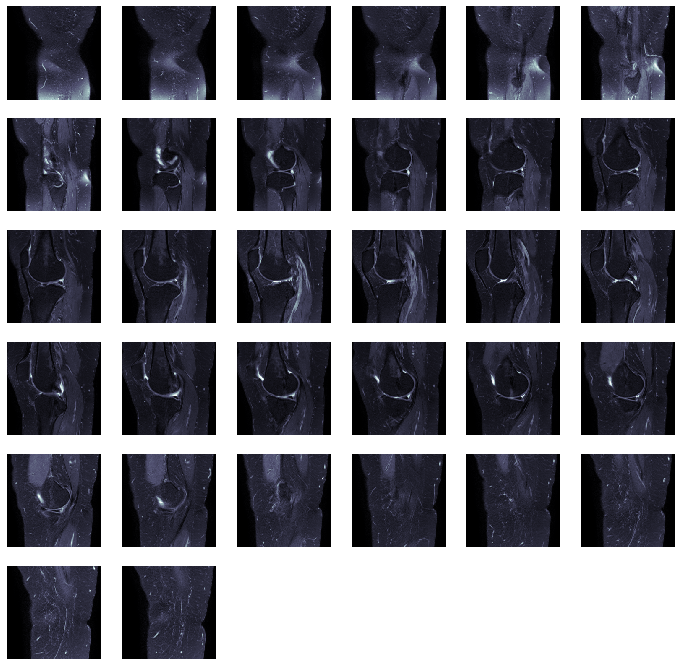

MR701_11cab199


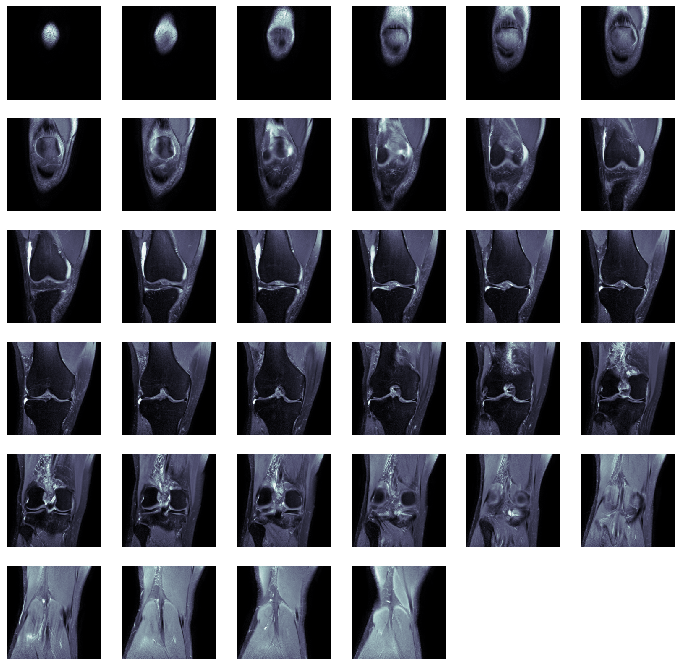

MR40004_872dc935


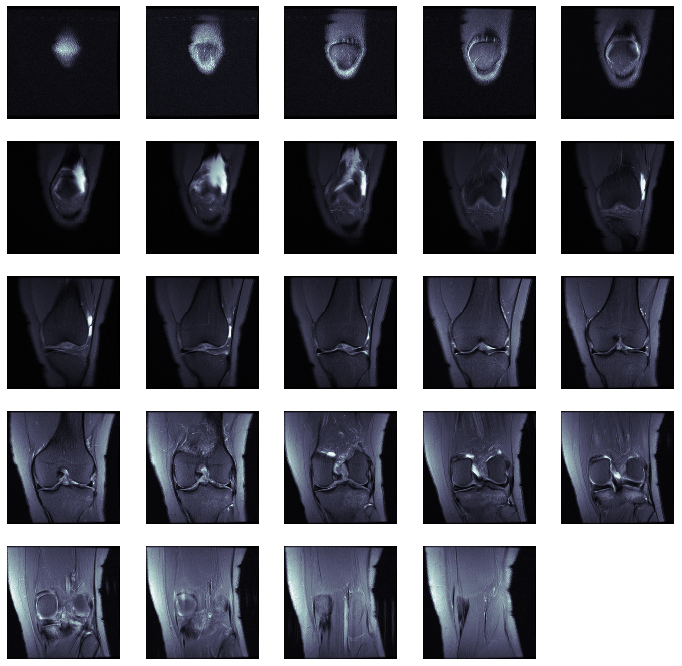

MR75_87310023


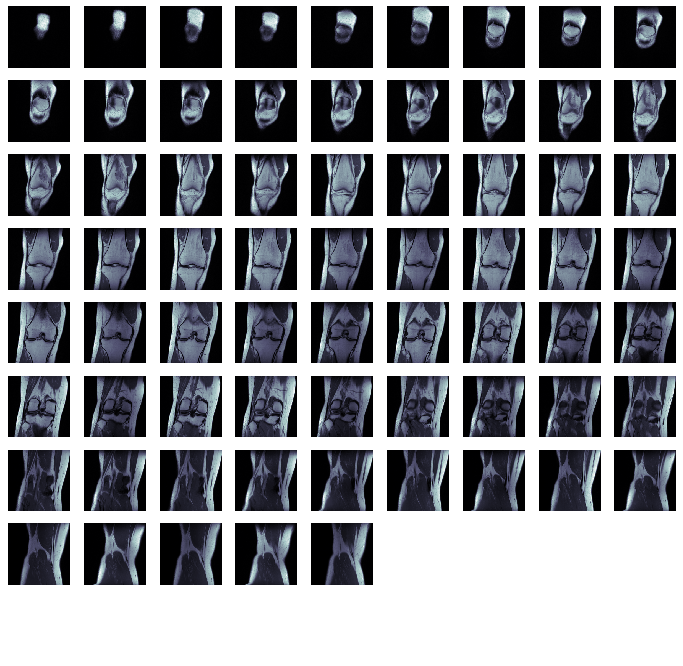

MR500_77c32b01


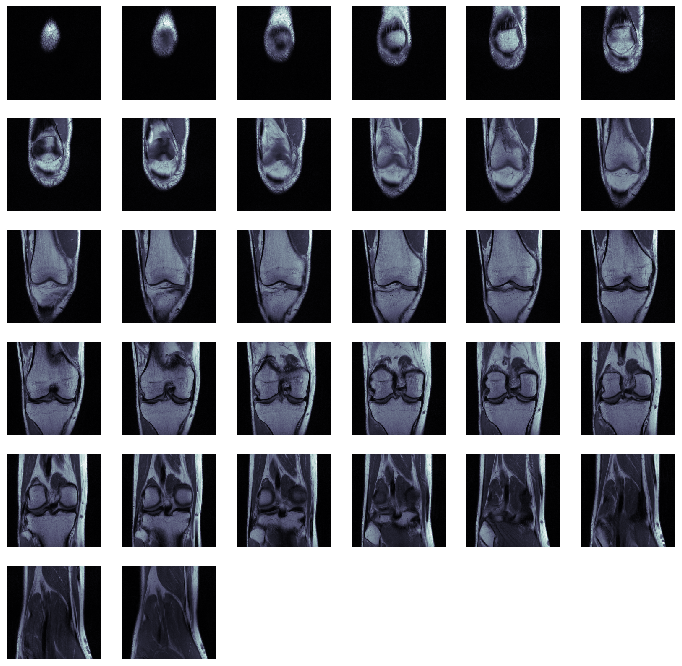

MR681_9e554a73


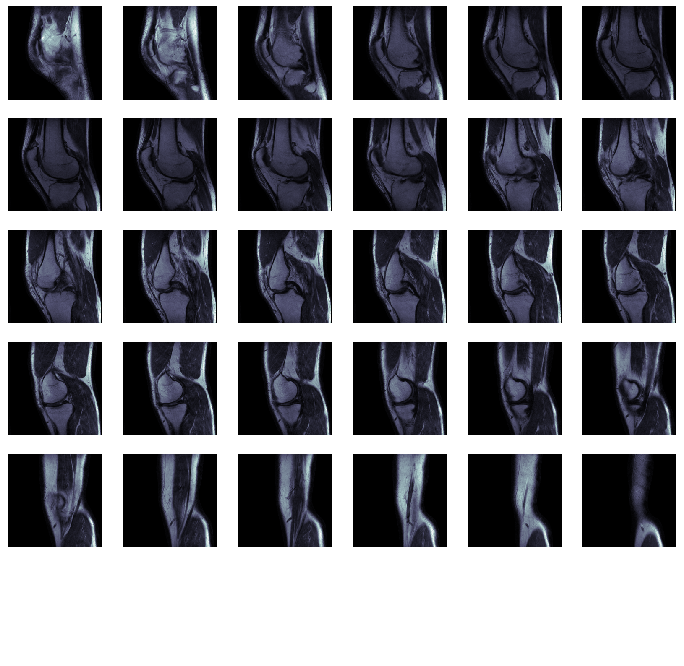

MR1301_774de23d


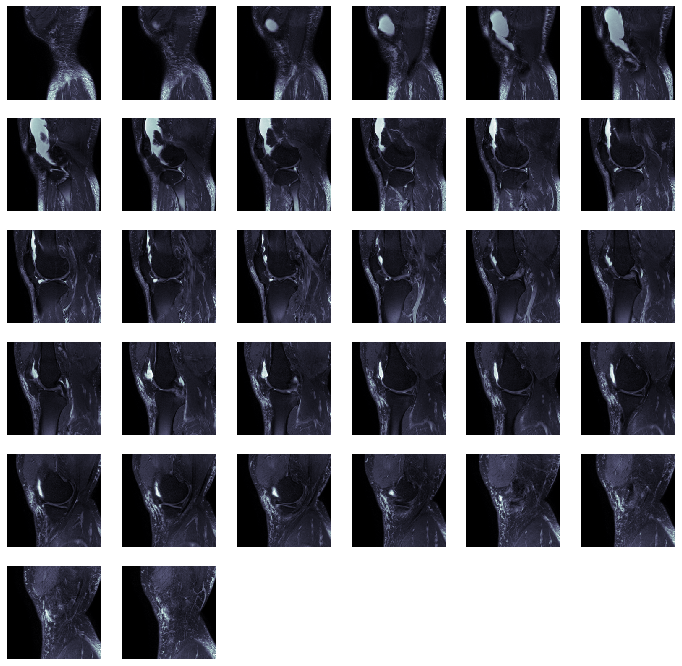

MR60_d093e4b5


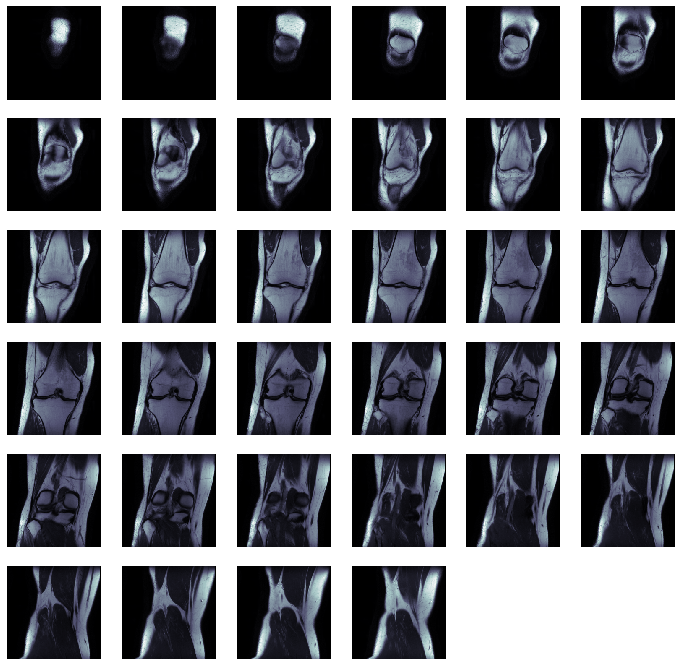

MR17_1cc465ff


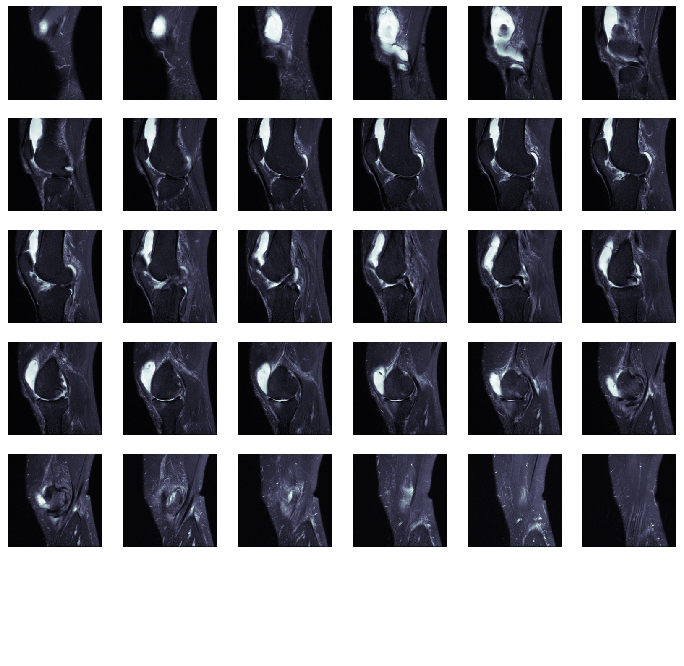

MR540_a9f6314f


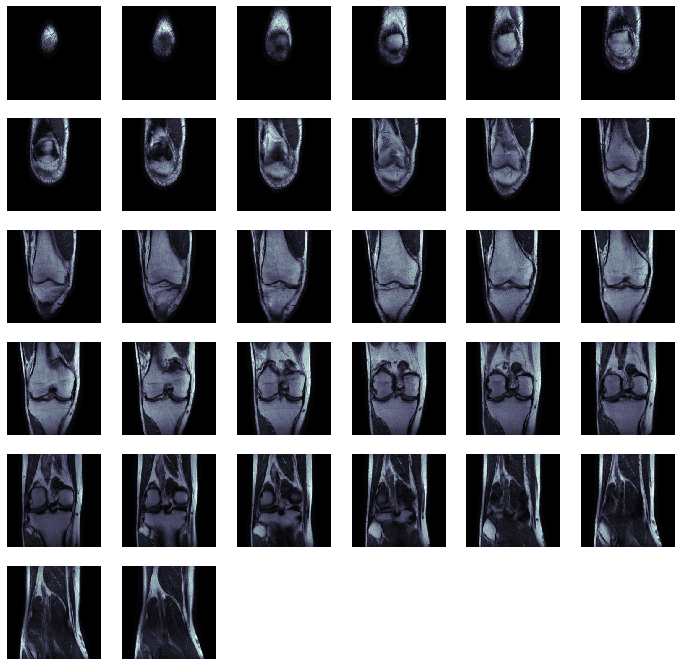

MR680_20ef4ba6


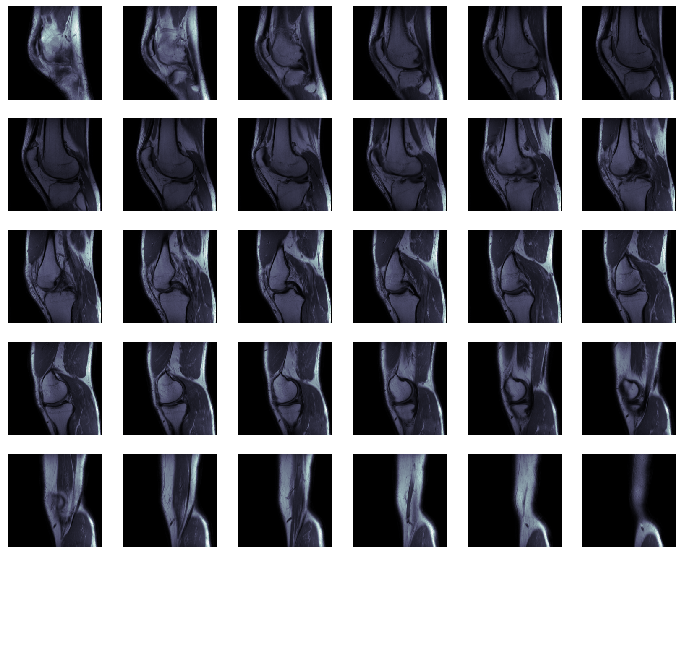

MR30_b1227b5f


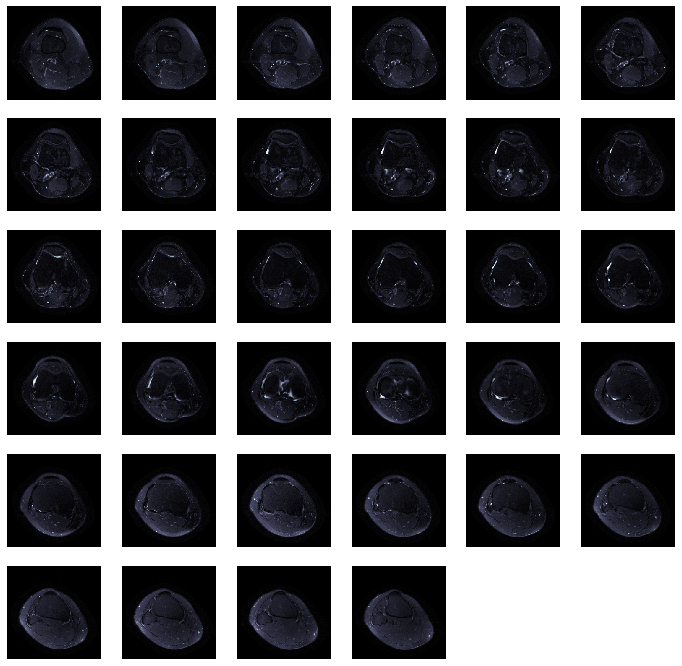

MR20_d9a442eb


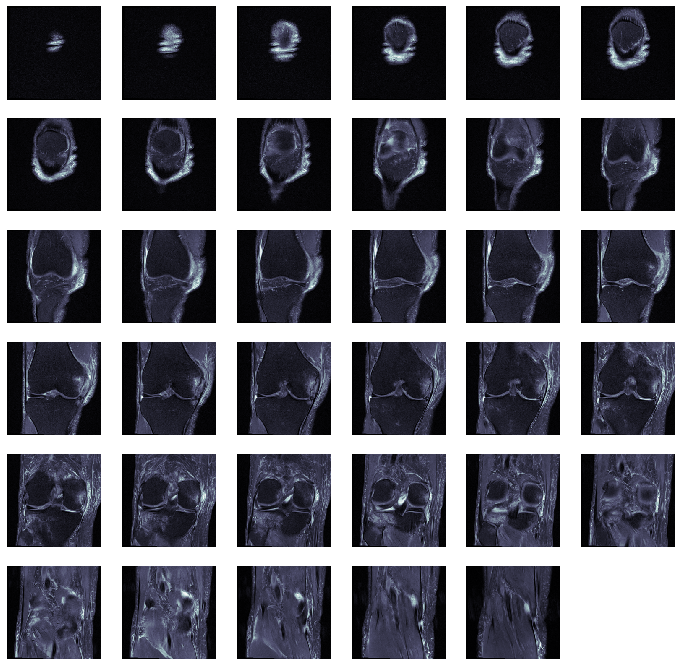

MR21_1ba45c6f


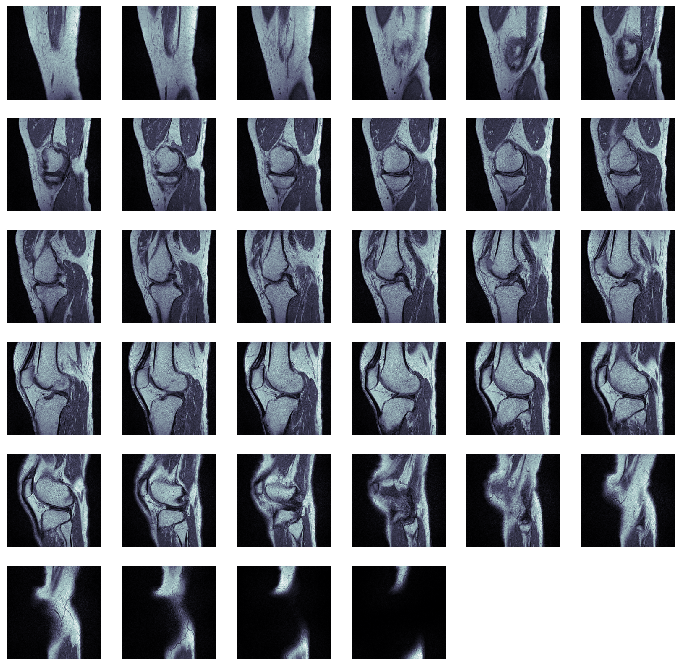

MR102_f4a1aee3


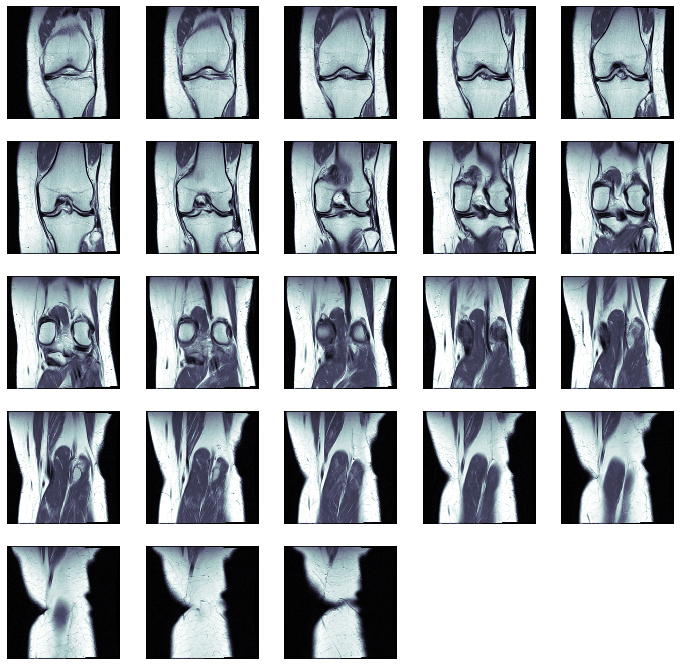

MR24_40cdc653


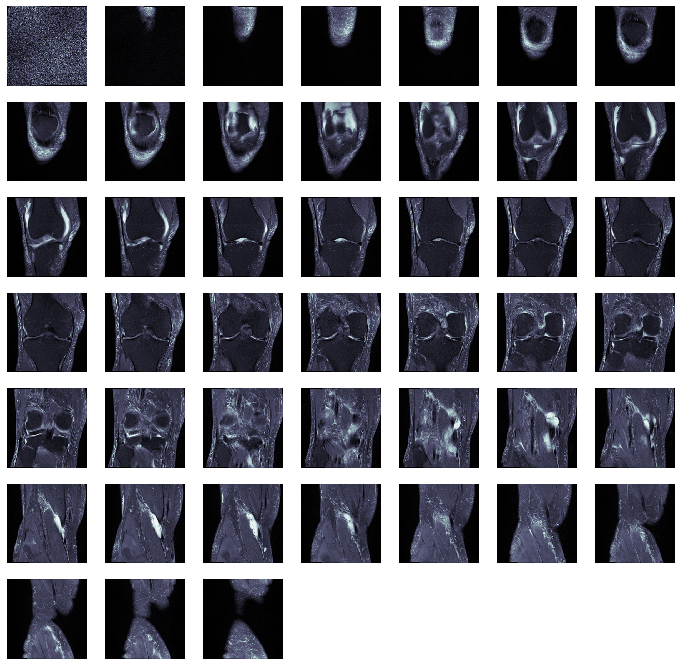

MR155_d5206740


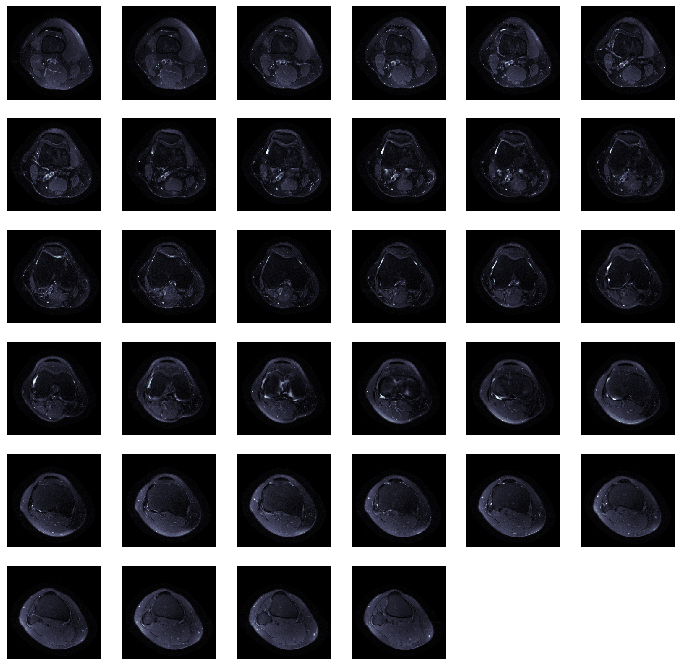

MR650_ec2d0970


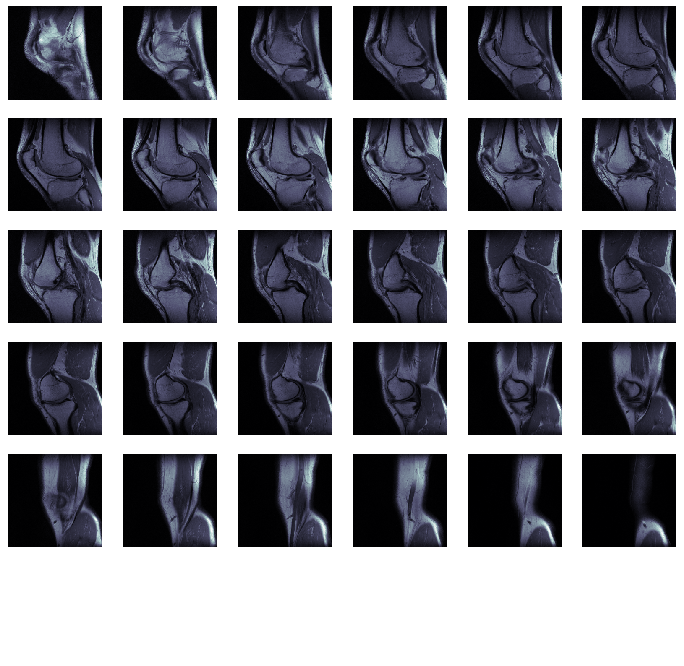

MR901_8b8b856f


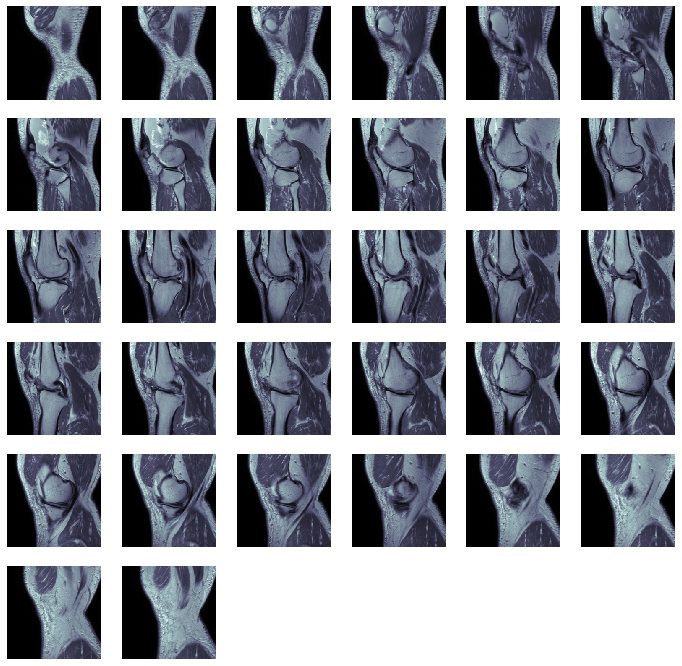

MR105_93b4bf27


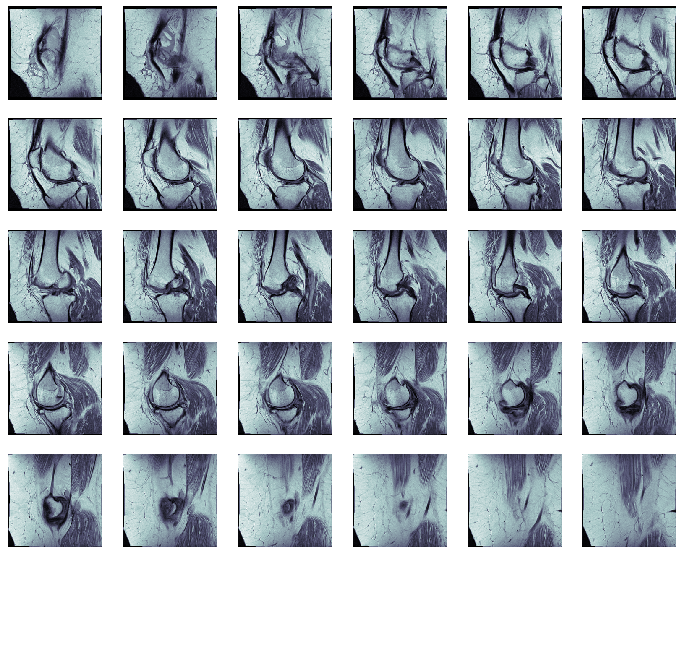

MR55_31444941


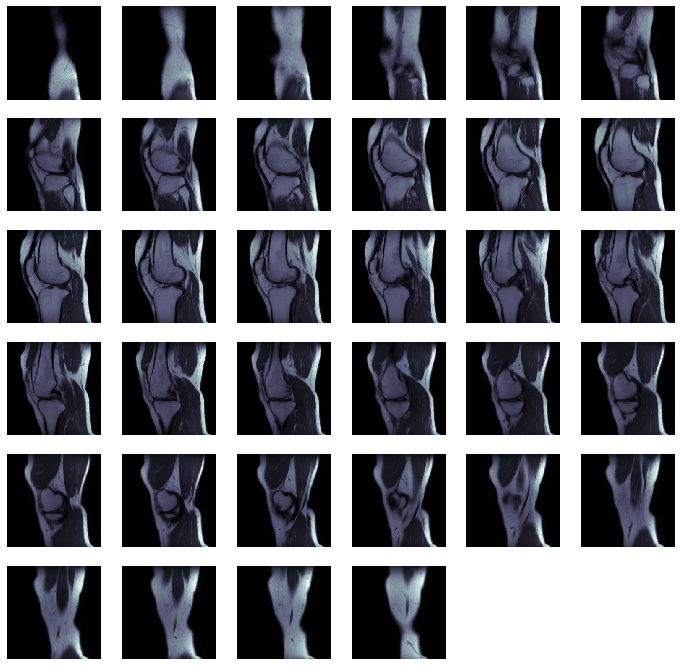

MR401_59efe520


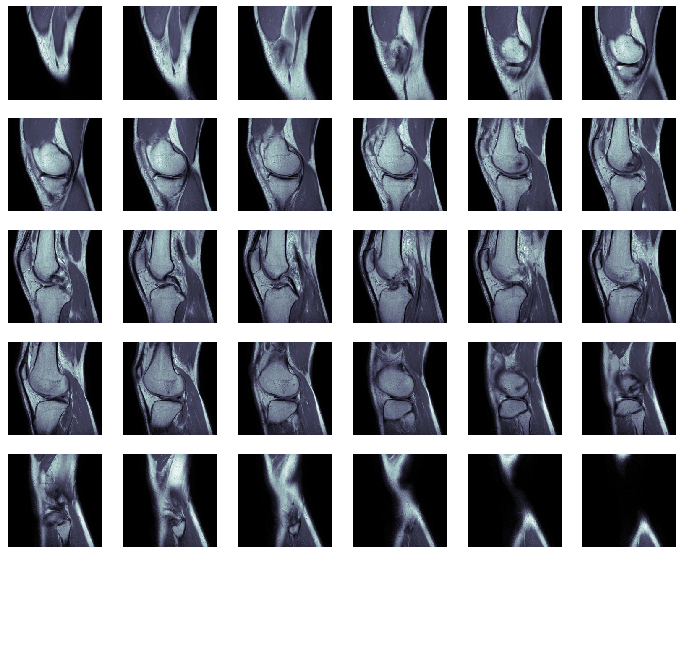

MR670_ae5b291b


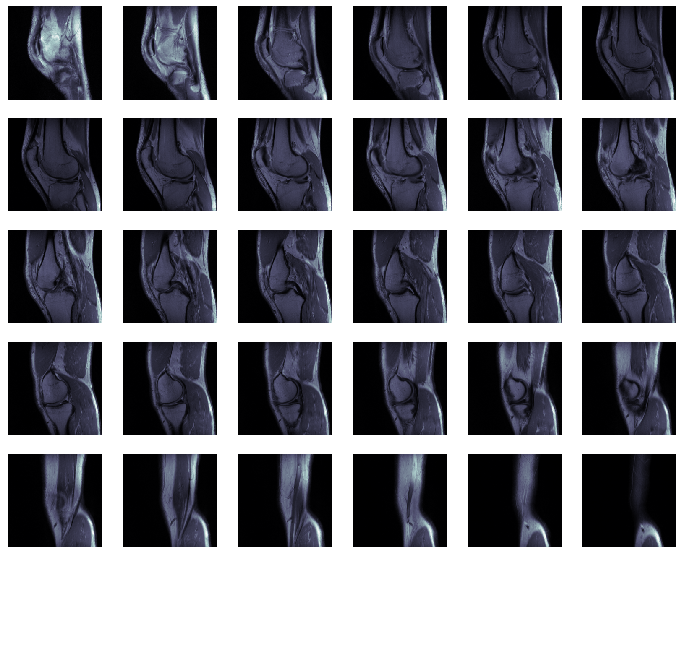

MR501_519b3941


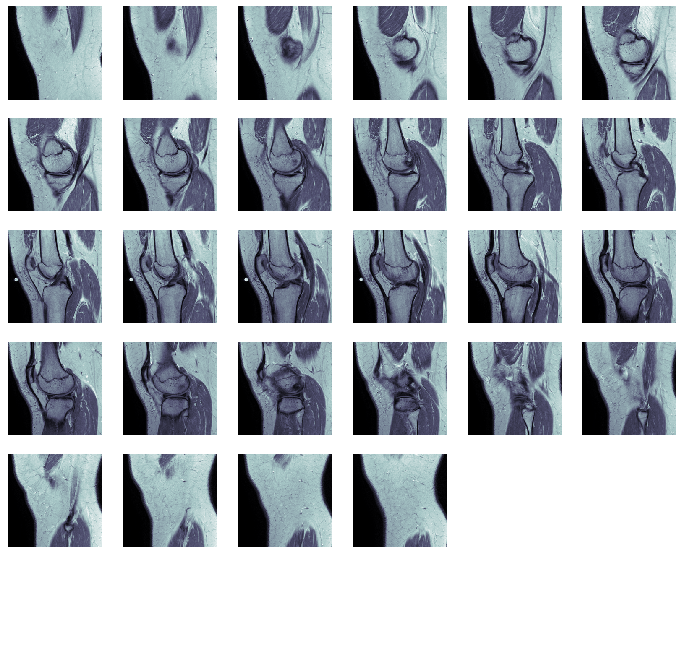

MR110100000_42fb2aa6


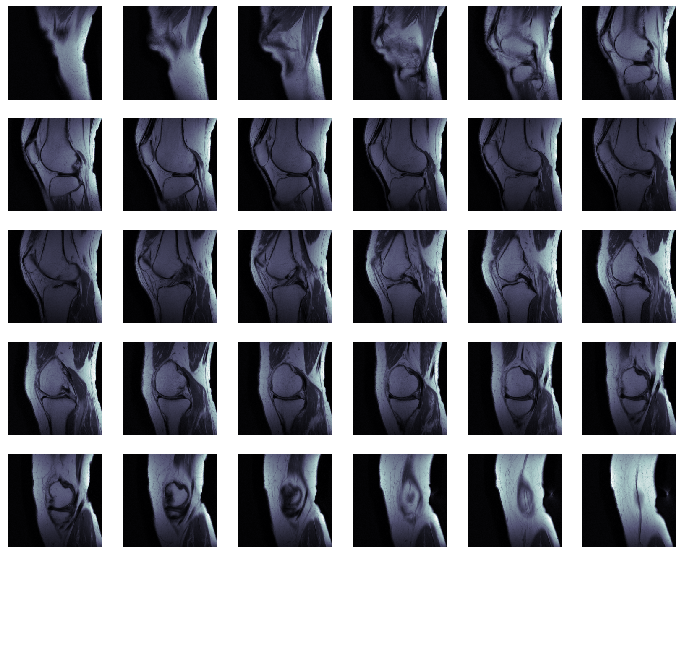

MR22_e0150e14


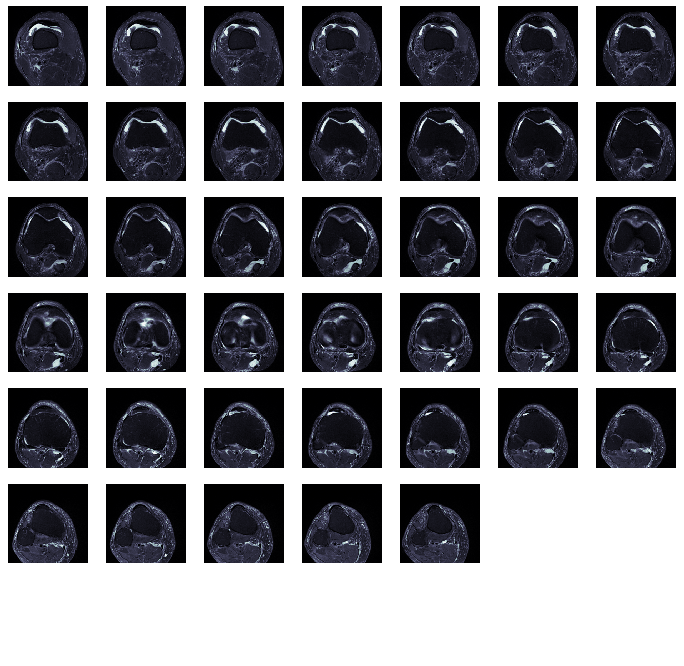

MR106_2918a355


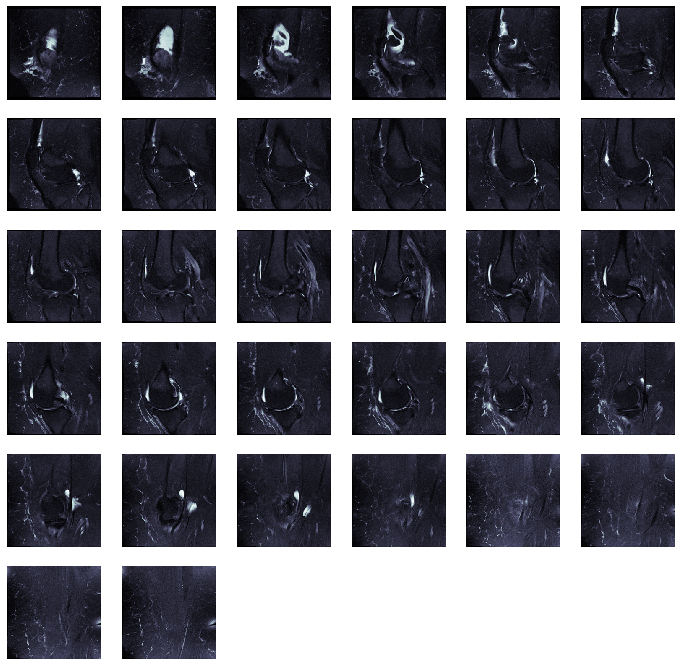

MR35_0eff0735


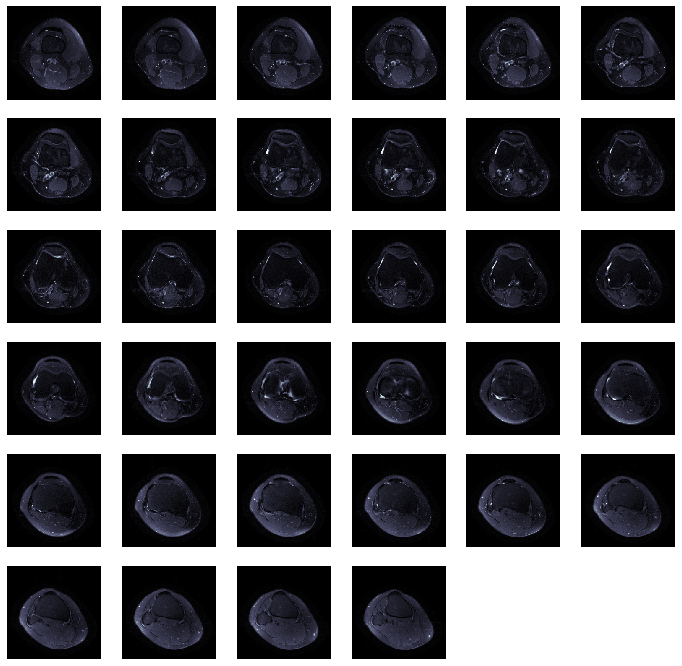

MR56_36b8b0a1


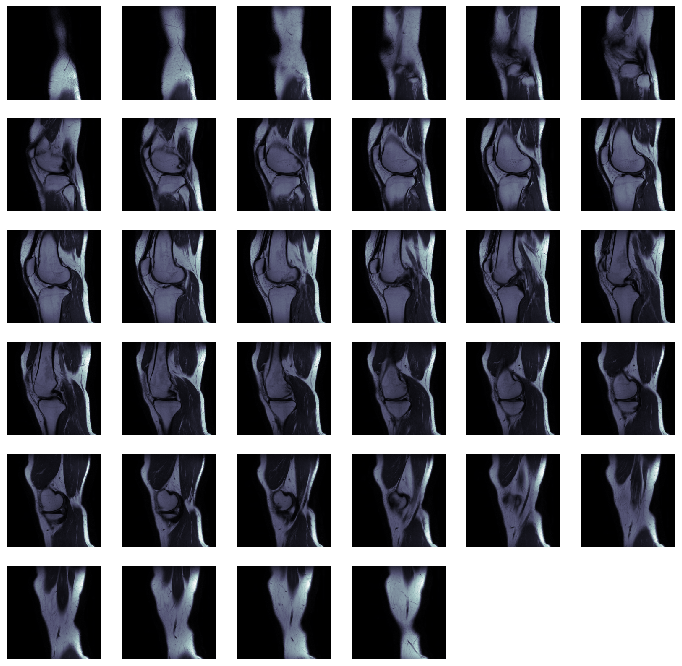

MR169_be2b9978


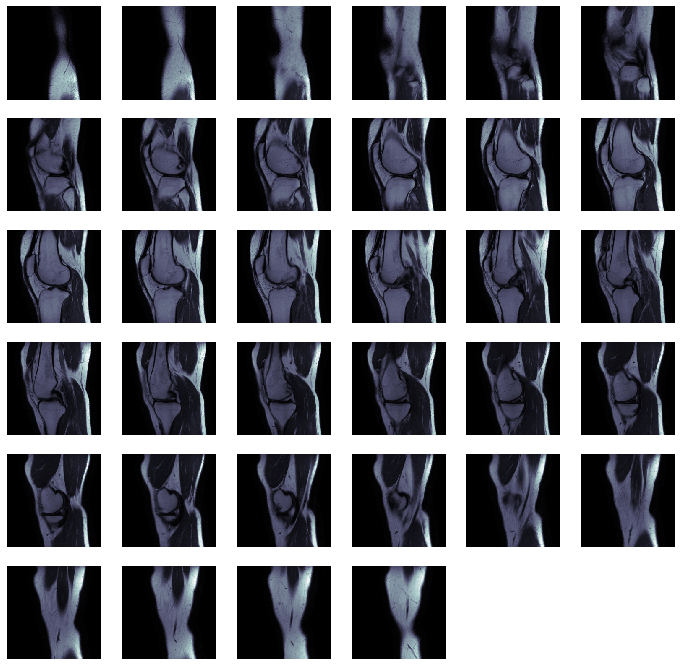

MR103_8302d17a


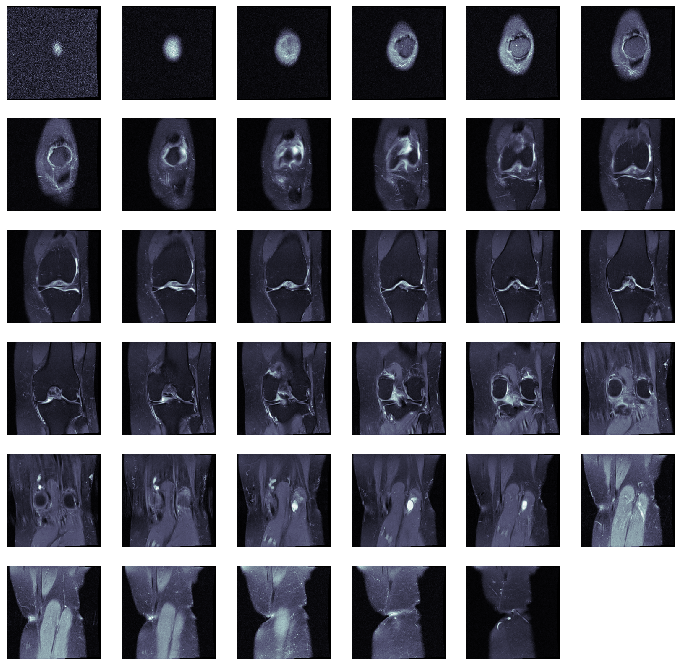

MR100_00901dbb


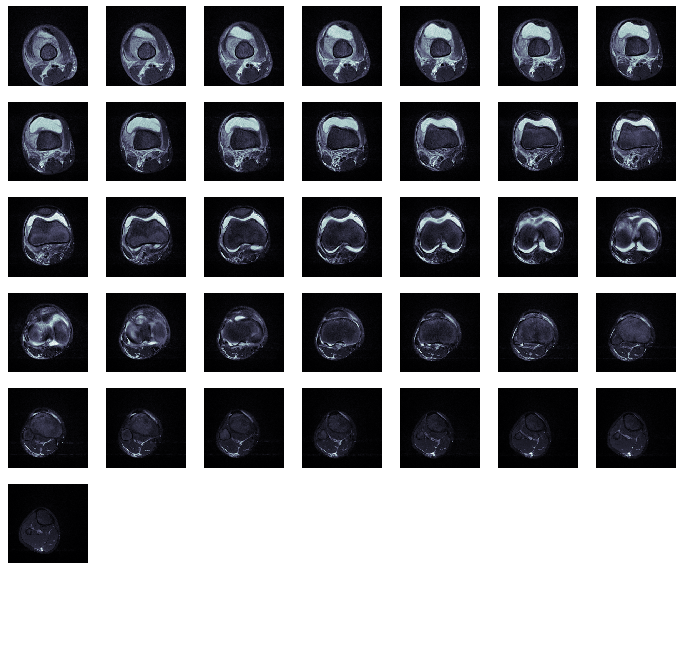

MR101_b58fb55d


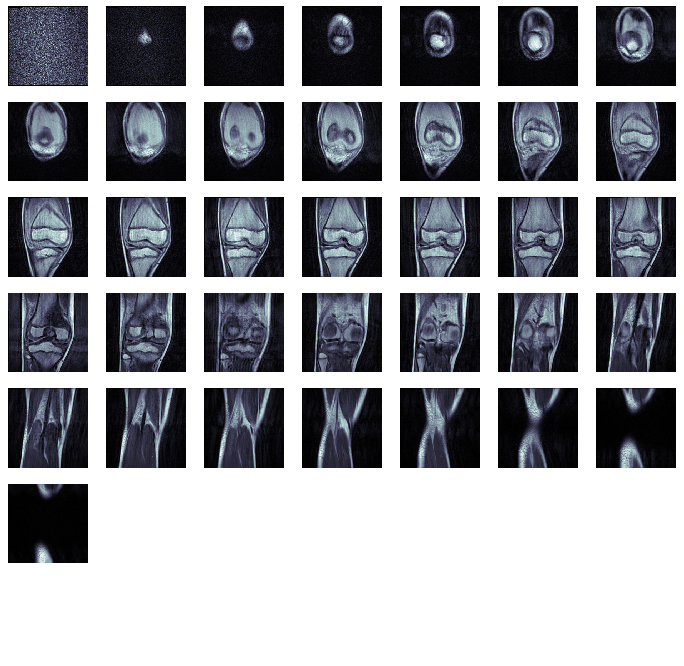

MR6001_3f8f6567


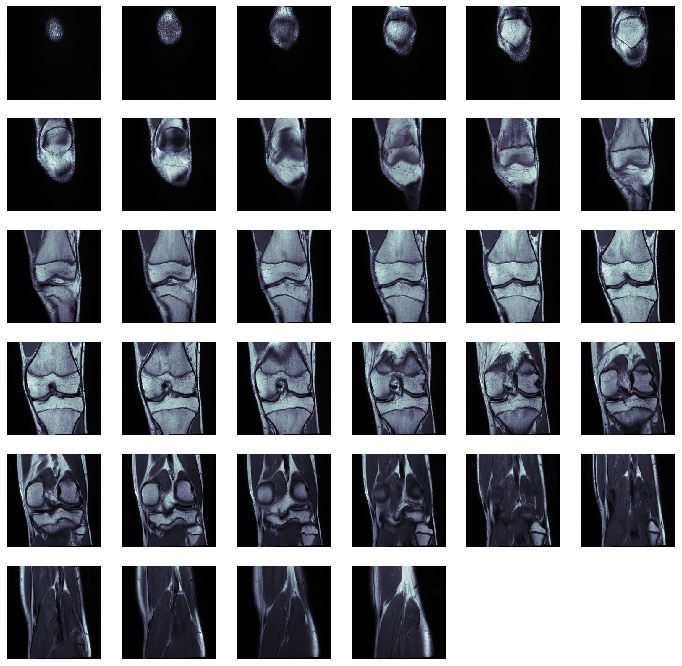

MR156_98afcadd


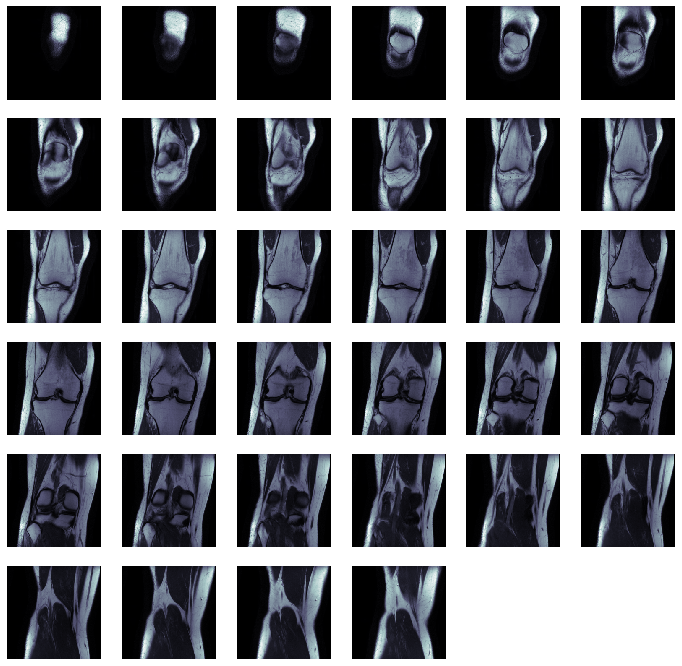

MR70_5bd2740a


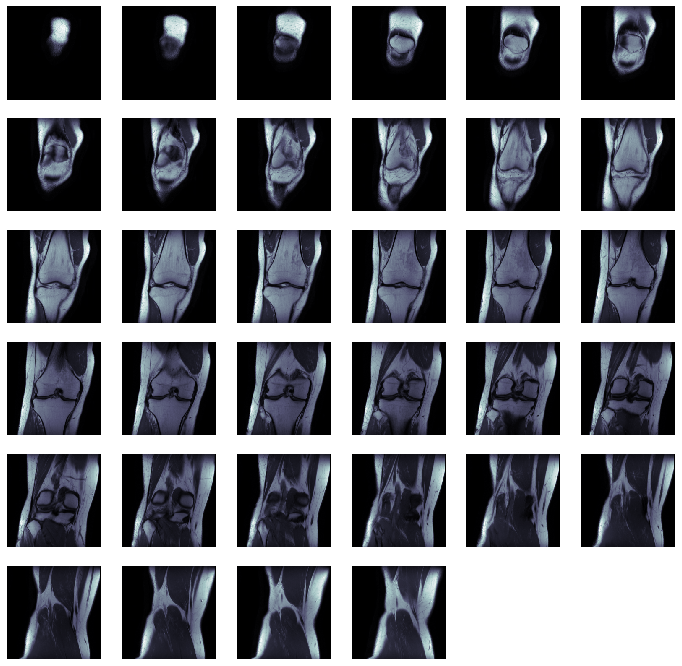

MR40003_802ade14


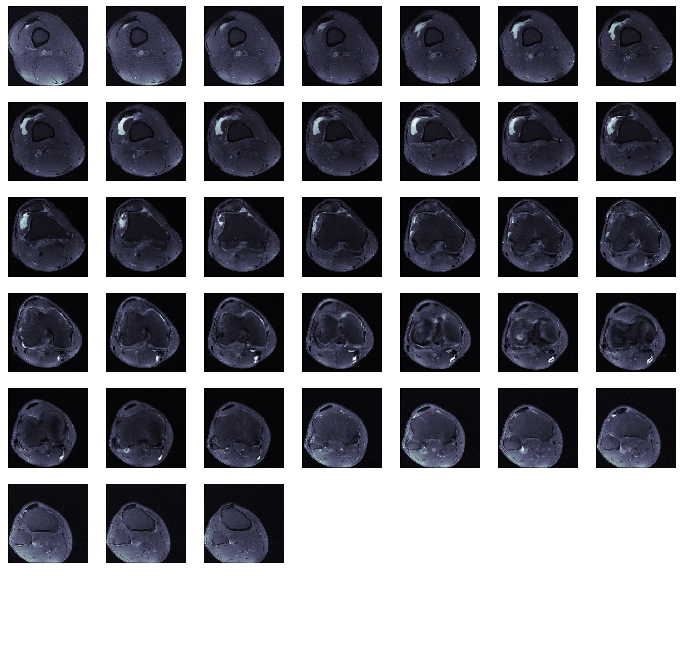

MR8001_f4353eb4


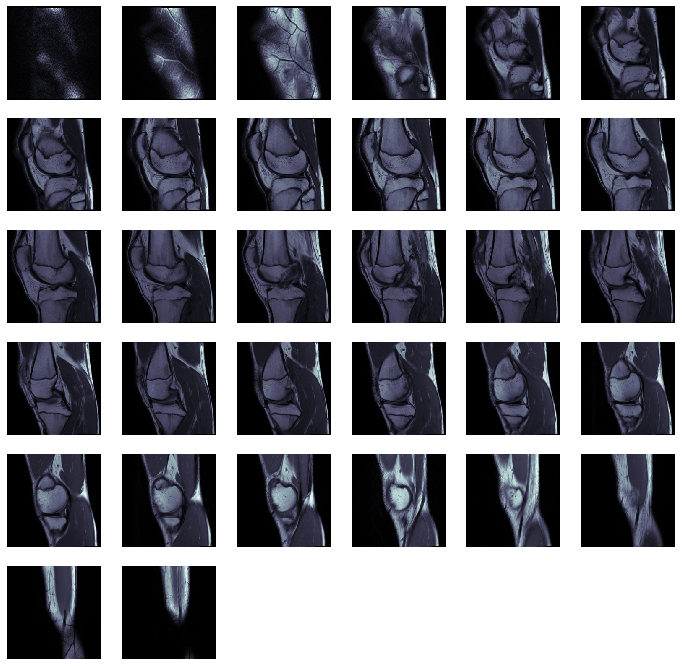

MR5001_87267b20


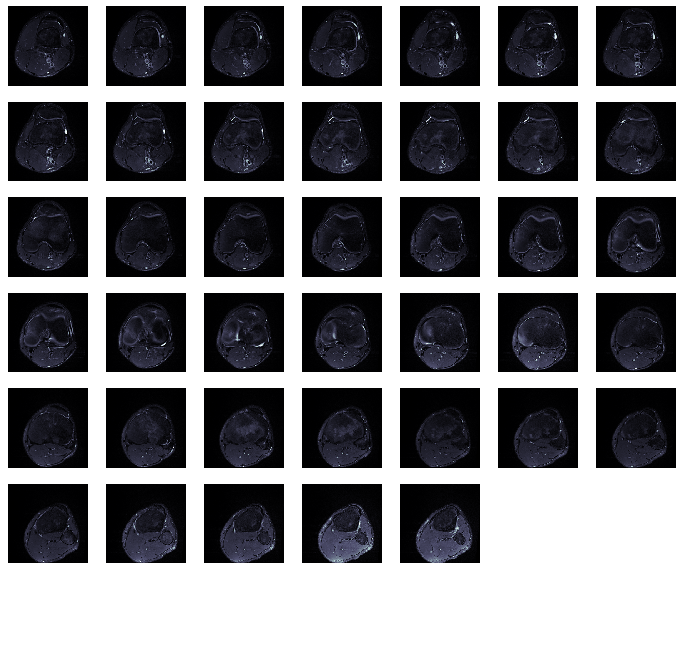

MR9001_2115aa78


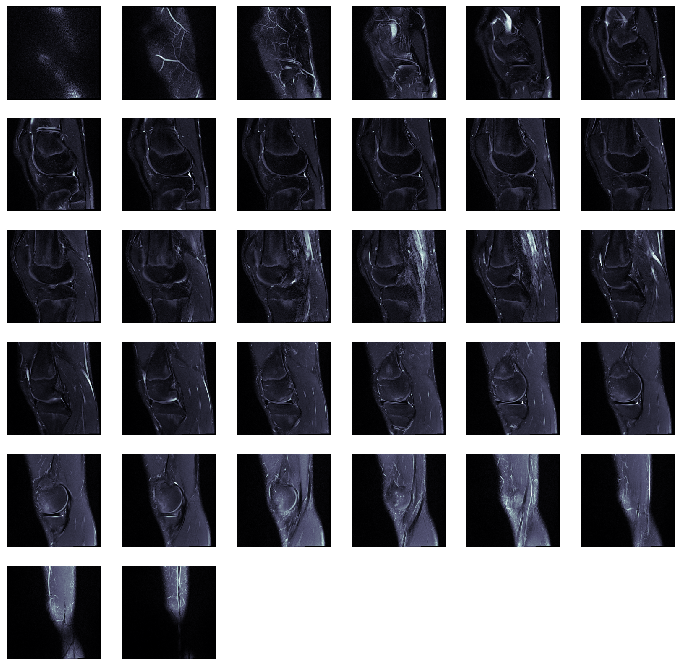

MR520_17c6cbdc


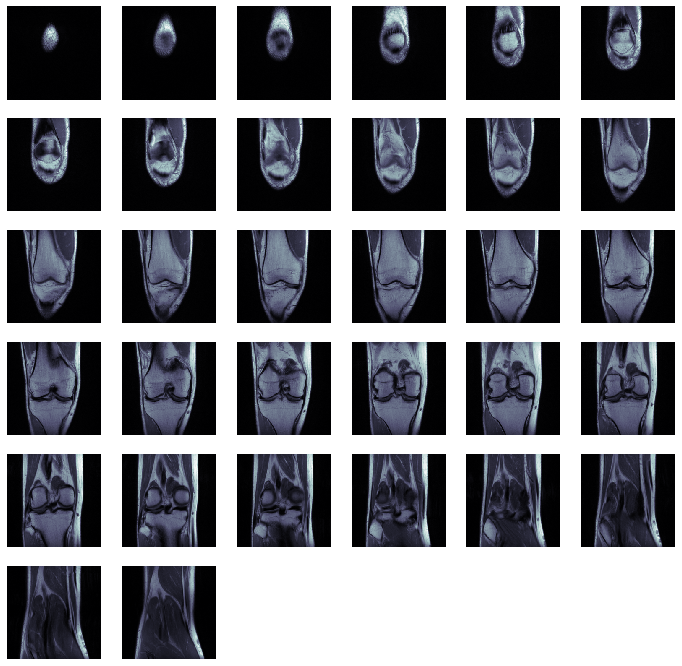

MR601_55e18a83


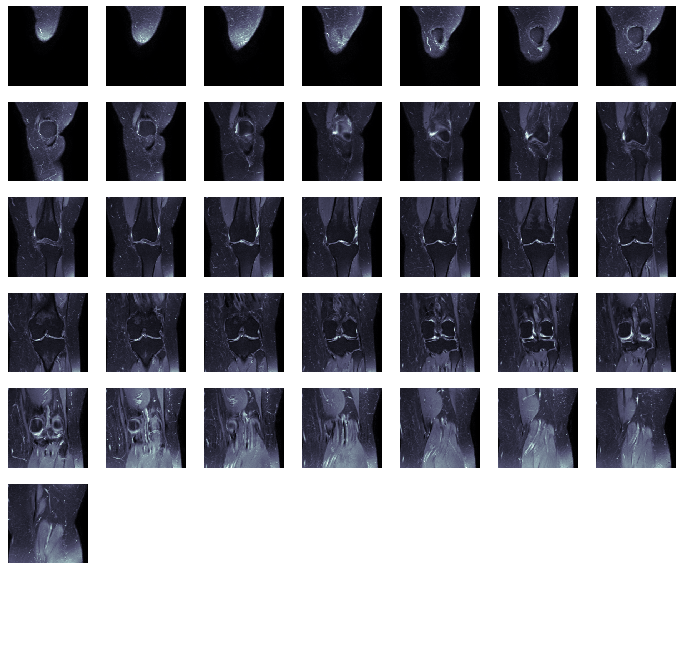

ValueError: not enough values to unpack (expected 2, got 1)

In [43]:
import numpy as np
import os
import matplotlib.pyplot as plt

# Specify the new path for numpy arrays
destination_path = "../data/fastMRI_knee_NUMPY"

# go through all folders!
files = os.listdir(destination_path)
files.remove("")
full_names = [fh.split(".")[0] for fh in files]

prefix_set = set()
for f in full_names:
    (prefix, patient) = f.split("_")
    if prefix not in prefix_set:
        prefix_set.add(prefix)
        print(f)
        arr = np.load(os.path.join(destination_path,f) + ".npy")
        slices = arr.shape[0]
        r,c =int(slices**.5)+1, int(slices**.5)+1
        fig, axs = plt.subplots(r,c)
        fig.set_size_inches(12, 12)
        for (i,j) in [(i,j) for i in range(r) for j in range(c)]:
            ind = i*r + j
            if ind<slices:
                axs[i][j].imshow(arr[i*r + j], cmap=plt.cm.bone)
            axs[i][j].axis('off')
        plt.show()

In [ ]:
w